<a href="https://colab.research.google.com/github/aborbala/tree-canopy/blob/main/05_01_Evaluation_RandCrowns.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
"""
YOLO Model Evaluation with RandCrowns Metric on Test Dataset

Loads pre-trained YOLOv8 instance segmentation models, performs inference on test
imagery, evaluates predictions against ground truth and cadaster data using RandCrowns
metric, and generates comprehensive performance visualizations.

Overview:
    Runs YOLOv8 inference on satellite tiles, converts mask predictions to polygons
    with world coordinates, computes RandCrowns scores against multiple reference sources
    (lidR ground truth, cadaster boundaries), analyzes detection metrics (AP, Recall),
    and visualizes results across street trees vs. park trees categories.

Main Sections:

    1. Configuration - Load model weights and set paths to imagery/annotations
    2. Single Tile Prediction - Run inference on individual test tiles with visualization
    3. RandCrowns Metric - Compute custom metric for tree crown detection quality
    4. Batch Evaluation - Process multiple tiles and aggregate RandCrowns scores
    5. Performance Analysis - Compare predictions vs. ground truth and cadaster
    6. Detection Metrics - Calculate AP, AP50, AP75, Recall at multiple IoU thresholds
    7. Tree Type Classification - Separate results for street trees vs. park trees
    8. BAMFOREST TestSet - Process external test dataset with mosaic assembly
    9. Visualization - Plot predictions with confidence scores in world/image coordinates

Key Data:

    Input:
    - Satellite imagery (.tif format, RGB channels)
    - Ground truth annotations (GeoJSON polygons from lidR)
    - Cadaster buffer boundaries (property cadastral data)
    - COCO format annotations (TestSet12023)
    - YOLOv8 model weights (.pt files)
    
    Output:
    - RandCrowns summary statistics (CSV)
    - AP/Recall metrics comparison across references
    - Visualization plots (RandCrowns distribution, detection metrics)
    - GeoJSON predictions with confidence scores

Processing Parameters:

    - YOLO confidence threshold: 0.1
    - IoU threshold: 0.3 (RandCrowns), 0.5/0.75 (AP metrics)
    - RandCrowns parameters: alpha=0.7, omega=1.2, gamma=3.0
    - Downsample factor: 5x (for TestSet processing)
    - Mosaic grid: 5x5 tiles (25 tiles per mosaic)

Key Features:

    - RandCrowns metric (custom evaluation for tree crowns)
    - Multi-reference comparison (lidR, cadaster, predictions)
    - Precision/Recall computation across IoU thresholds
    - Tree type classification (street vs. park trees)
    - Mosaic assembly for large-area analysis
    - World coordinate transformation (pixel to UTM)
    - Confidence-based sorting for AP calculation
    - Detection outcome tracking (TP, FP, FN)

Workflow:

    1. Load YOLOv8 model and configure input directories
    2. Run single tile prediction with world/image coordinate visualization
    3. Compute RandCrowns scores (GT vs. Prediction)
    4. Process batch of tiles and aggregate metrics per tile
    5. Calculate AP@0.5, AP@0.75 against ground truth and cadaster
    6. Classify tiles as street or park trees
    7. Analyze deviation from cadaster by tree type
    8. Process external TestSet12023 with mosaic assembly
    9. Generate boxplots and bar charts for performance comparison

RandCrowns Metric:

    Custom metric for tree crown detection quality combining:
    - Intersection area (prediction ∩ ground truth)
    - Outer buffer (distance tolerance)
    - Inner core (minimum required overlap)
    - Radial buffer zones with asymmetric weighting
    
    Ranges [0, 1], higher = better detection accuracy
"""

# --- Setup ---

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
!pip install geopandas shapely fiona pyproj ultralytics rasterio

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.6/56.6 kB 3.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 17.2/17.2 MB 53.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 47.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 22.3/22.3 MB 67.9 MB/s eta 0:00:00


In [ ]:
import os
import random
import rasterio
import numpy as np
from rasterio.transform import from_bounds
import geopandas as gpd
from shapely.geometry import Polygon, box
from rasterio.features import shapes
from shapely.geometry import shape as geom_shape
from ultralytics import YOLO
import cv2
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import json

# --- Configuration ---

In [ ]:
aoi_code = "384_5816" # test dataset

# === Paths ===
raster_dir = f"/content/drive/MyDrive/masterthesis/data/{aoi_code}/sliced_imgs_2020S"
groundtruth_dir = f"/content/drive/MyDrive/masterthesis/data/{aoi_code}/crowns_clean_no_structures_veg_mask"
cadaster_dir = f"/content/drive/MyDrive/masterthesis/data/{aoi_code}/cadaster_points/"
tiles_path = f"/content/drive/MyDrive/masterthesis/data/{aoi_code}/tiles.geojson"

model_name="no_struct_veg_mask_all_crowns"
#model_name="no_struct_veg_mask_one_class"
#model_name="no_struct_veg_mask_ignore_region"
#model_name="no_struct_veg_mask_one_class_dice_loss"
#model_name="no_struct_veg_mask_all_crowns_dice_loss"

if model_name == "no_struct_veg_mask_all_crowns":
    model_label = "All crowns, default losses"
elif model_name == "no_struct_veg_mask_one_class":
    model_label = "Only cadaster intersections, others as background, default losses"
elif model_name == "no_struct_veg_mask_ignore_region":
    model_label = "Only cadaster intersections, loss with don't care region"
elif model_name == "no_struct_veg_mask_one_class_dice_loss":
    model_label = "Only cadaster intersections, others as background, default losses with dice loss"
elif model_name == "no_struct_veg_mask_all_crowns_dice_loss":
    model_label = "All crowns, default losses with dice loss"
else:
    model_label = "Unknown model"


# Load YOLO model
model = YOLO(f'/content/drive/MyDrive/masterthesis/data/runs/{model_name}/weights/last.pt')

# === Load Tiles ===
tiles_gdf = gpd.read_file(tiles_path)

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


# --- Functions ---

In [5]:
def masks_to_polygons(masks, original_bounds, out_shape, scores, min_area=1.0):
    polygons = []
    properties = []

    # New transform based on actual image bounds and mask shape
    transform = from_bounds(*original_bounds, width=out_shape[1], height=out_shape[0])

    for i, mask in enumerate(masks):
        # Ensure mask is resized to original raster shape
        mask_resized = cv2.resize(mask.astype(np.uint8), (out_shape[1], out_shape[0]), interpolation=cv2.INTER_NEAREST)

        for geom, val in shapes(mask_resized, mask=mask_resized, transform=transform):
            poly = geom_shape(geom)
            if poly.area > min_area:
                polygons.append(poly)
                properties.append({'confidence': float(scores[i])})

    gdf = gpd.GeoDataFrame(properties, geometry=polygons)
    return gdf

In [6]:
def plot_prediction_world_coords(image_path, groundtruth_gdf=None, cadaster_gdf=None, pred_polygons=None):
    with rasterio.open(image_path) as src:
        image = src.read([1, 2, 3])
        image = np.moveaxis(image, 0, -1)
        crs = src.crs
        extent = [src.bounds.left, src.bounds.right, src.bounds.bottom, src.bounds.top]

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(image, extent=extent)

    # Plot predicted polygons (in world coordinates)
    if pred_polygons is not None and not pred_polygons.empty:
        pred_polygons.boundary.plot(ax=ax, edgecolor="cyan", linewidth=2, linestyle="--", label="Predicted Crowns")

    # Ground truth crowns
    if groundtruth_gdf is not None and not groundtruth_gdf.empty:
        groundtruth_gdf.boundary.plot(ax=ax, edgecolor="orange", linewidth=2, label="lidR")

    # Cadaster buffer
    if cadaster_gdf is not None and not cadaster_gdf.empty:
        cadaster_gdf.boundary.plot(ax=ax, edgecolor="blue", linewidth=2, linestyle=":", label="Cadaster Buffer")

    ax.set_title(f"{model_label} - {os.path.basename(image_path)}")
    ax.set_xlabel("Easting (meters)")
    ax.set_ylabel("Northing (meters)")
    ax.legend()
    plt.tight_layout()
    plt.show()


In [7]:
def plot_prediction_img_coords(image_path, results, groundtruth_gdf=None, cadaster_gdf=None, pred_polygons=None):
    with rasterio.open(image_path) as src:
        image = src.read([1, 2, 3])
        image = np.moveaxis(image, 0, -1)
        height, width, _ = image.shape

        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(image)

        # Plot YOLO masks
        if results[0].masks is not None:
            for mask in results[0].masks.data:
                mask = mask.cpu().numpy()
                if mask.ndim == 3:
                    mask = mask[0]
                mask_resized = cv2.resize(mask, (width, height))
                ax.contour(mask_resized, levels=[0.5], colors='red', linewidths=1.5)

        # Plot YOLO boxes with confidence
        if results[0].boxes is not None:
            for box in results[0].boxes:
                x_min, y_min, x_max, y_max = box.xyxy[0].cpu().numpy()
                conf = float(box.conf.cpu().numpy())  # Extract confidence
                ax.add_patch(plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                           edgecolor="lime", facecolor="none", linewidth=2))
                ax.text(x_min, y_min - 5, f'{conf:.2f}', color='yellow', fontsize=8, backgroundcolor='black')

        ax.set_title(f"{model_label} — {os.path.basename(image_path)}")
        ax.set_xlabel("Pixel X")
        ax.set_ylabel("Pixel Y")
        ax.legend(handles=[
            plt.Line2D([0], [0], color='red', lw=2, label='Mask Contour'),
            plt.Line2D([0], [0], color='lime', lw=2, label='Prediction Box')
        ])
        plt.tight_layout()
        plt.show()


# --- Processing ---

Single prediction

In [8]:
tif_files = [f for f in os.listdir(raster_dir) if f.endswith(".tif")]
# tif_file = tif_files[19]
tif_file = "3dm_33_384_5817_1_be_nobuild_33.tif"
#tif_file= "3dm_33_384_5817_1_be_nobuild_85.tif"
print(tif_files)

['3dm_33_384_5816_1_be_nobuild_0.tif', '3dm_33_384_5816_1_be_nobuild_1.tif', '3dm_33_384_5816_1_be_nobuild_2.tif', '3dm_33_384_5816_1_be_nobuild_3.tif', '3dm_33_384_5816_1_be_nobuild_4.tif', '3dm_33_384_5816_1_be_nobuild_5.tif', '3dm_33_384_5816_1_be_nobuild_6.tif', '3dm_33_384_5816_1_be_nobuild_7.tif', '3dm_33_384_5816_1_be_nobuild_8.tif', '3dm_33_384_5816_1_be_nobuild_9.tif', '3dm_33_384_5816_1_be_nobuild_10.tif', '3dm_33_384_5816_1_be_nobuild_11.tif', '3dm_33_384_5816_1_be_nobuild_12.tif', '3dm_33_384_5816_1_be_nobuild_13.tif', '3dm_33_384_5816_1_be_nobuild_14.tif', '3dm_33_384_5816_1_be_nobuild_15.tif', '3dm_33_384_5816_1_be_nobuild_16.tif', '3dm_33_384_5816_1_be_nobuild_17.tif', '3dm_33_384_5816_1_be_nobuild_18.tif', '3dm_33_384_5816_1_be_nobuild_19.tif', '3dm_33_384_5816_1_be_nobuild_20.tif', '3dm_33_384_5816_1_be_nobuild_21.tif', '3dm_33_384_5816_1_be_nobuild_22.tif', '3dm_33_384_5816_1_be_nobuild_23.tif', '3dm_33_384_5816_1_be_nobuild_24.tif', '3dm_33_384_5816_1_be_nobuild_25.t

In [ ]:
tile_name = tif_file.replace(".tif", "")
raster_path = os.path.join(raster_dir, tif_file)
print(f"Processing tile: {tile_name}")

# Get matching tile extent from tiles.geojson
tile_row = tiles_gdf[tiles_gdf["tile_name"] == tile_name]
if tile_row.empty:
    print("Tile not found in tiles.geojson, skipping.")

tile_geom = tile_row.geometry.values[0]
tile_bounds = tile_geom.bounds

crs = tiles_gdf.crs

# Read raster and get transform
with rasterio.open(raster_path) as src:
    image = src.read([1, 2, 3])
    image = np.moveaxis(image, 0, -1)
    bounds = src.bounds
    crs = src.crs
    shape = image.shape[:2]  # (height, width)

# Run YOLO inference
results = model(raster_path, imgsz=640, conf=0.1, iou=0.3, verbose=False)
if results[0].masks is None:
    print("No masks found.")

# Convert masks to polygons
masks = results[0].masks.data.cpu().numpy()
scores = results[0].boxes.conf.cpu().numpy()

gdf_pred = masks_to_polygons(masks, original_bounds=bounds, out_shape=shape, scores=scores)
gdf_pred["tile"] = tile_name

# Clip to tile extent to avoid edge artifacts
gdf_pred = gpd.clip(gdf_pred, tile_geom)

gdf_pred.set_crs(crs, inplace=True)

print("Tiles CRS:", tiles_gdf.crs)
print("Predictions CRS:", gdf_pred.crs)

# save to GeoJSON
output_path = f"/content/drive/MyDrive/masterthesis/predictions/{tile_name}_{model_name}_pred.geojson"
os.makedirs(os.path.dirname(output_path), exist_ok=True)
gdf_pred.to_file(output_path, driver="GeoJSON")
print(f"✅ Saved predictions to {output_path}")



🔍 Processing tile: 3dm_33_384_5817_1_be_nobuild_33
Tiles CRS: EPSG:25833
Predictions CRS: None


/usr/local/lib/python3.12/dist-packages/pyogrio/geopandas.py:710: UserWarning: 'crs' was not provided.  The output dataset will not have projection information defined and may not be usable in other systems.
  write(


✅ Saved predictions to /content/drive/MyDrive/masterthesis/predictions/3dm_33_384_5817_1_be_nobuild_33_no_struct_veg_mask_all_crowns_pred.geojson


In [ ]:
groundtruth_path = os.path.join(groundtruth_dir, f"{tile_name}.geojson")
cadaster_path = os.path.join(cadaster_dir, f"{tile_name}.geojson")

if os.path.exists(groundtruth_path):
    gdf_gt = gpd.read_file(groundtruth_path)
    gdf_gt = gdf_gt.set_crs(crs, allow_override=True)
    gdf_gt = gpd.clip(gdf_gt, tile_geom)
    print(f"Loaded ground truth: {groundtruth_path}")
else:
    print(f"Ground truth not found for {tile_name}")

if os.path.exists(cadaster_path):
    gdf_cadaster = gpd.read_file(cadaster_path)
    gdf_cadaster = gdf_cadaster.set_crs(crs, allow_override=True)
    gdf_cadaster = gpd.clip(gdf_cadaster, tile_geom)
    print(f"Loaded cadaster buffer: {cadaster_path}")
else:
    print(f"Cadaster buffer not found for {tile_name}")

✅ Loaded ground truth: /content/drive/MyDrive/masterthesis/data/384_5816/crowns_clean_no_structures_veg_mask/3dm_33_384_5817_1_be_nobuild_33.geojson
✅ Loaded cadaster buffer: /content/drive/MyDrive/masterthesis/data/384_5816/cadaster_points/3dm_33_384_5817_1_be_nobuild_33.geojson


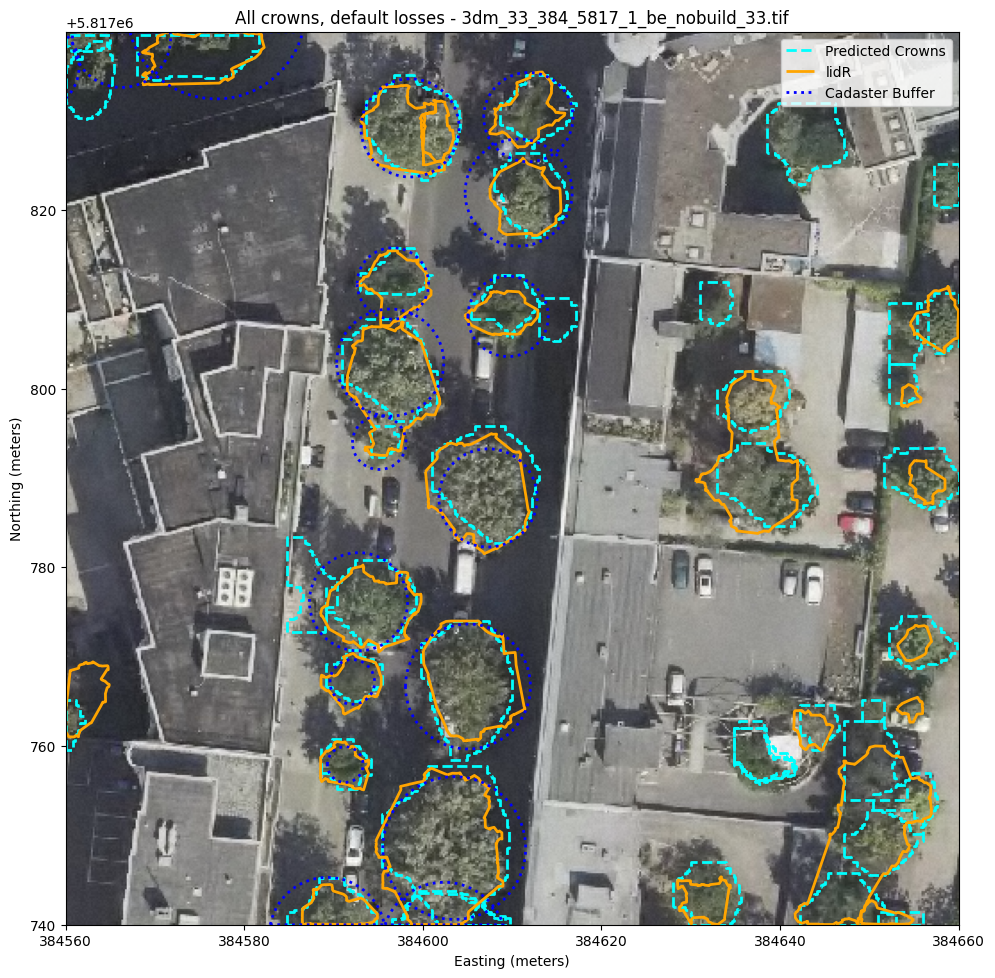

In [11]:
test_img = os.path.join(raster_dir, tif_file)
plot_prediction_world_coords(test_img, gdf_gt, gdf_cadaster, gdf_pred)

/tmp/ipython-input-3864870417.py:23: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  conf = float(box.conf.cpu().numpy())  # Extract confidence


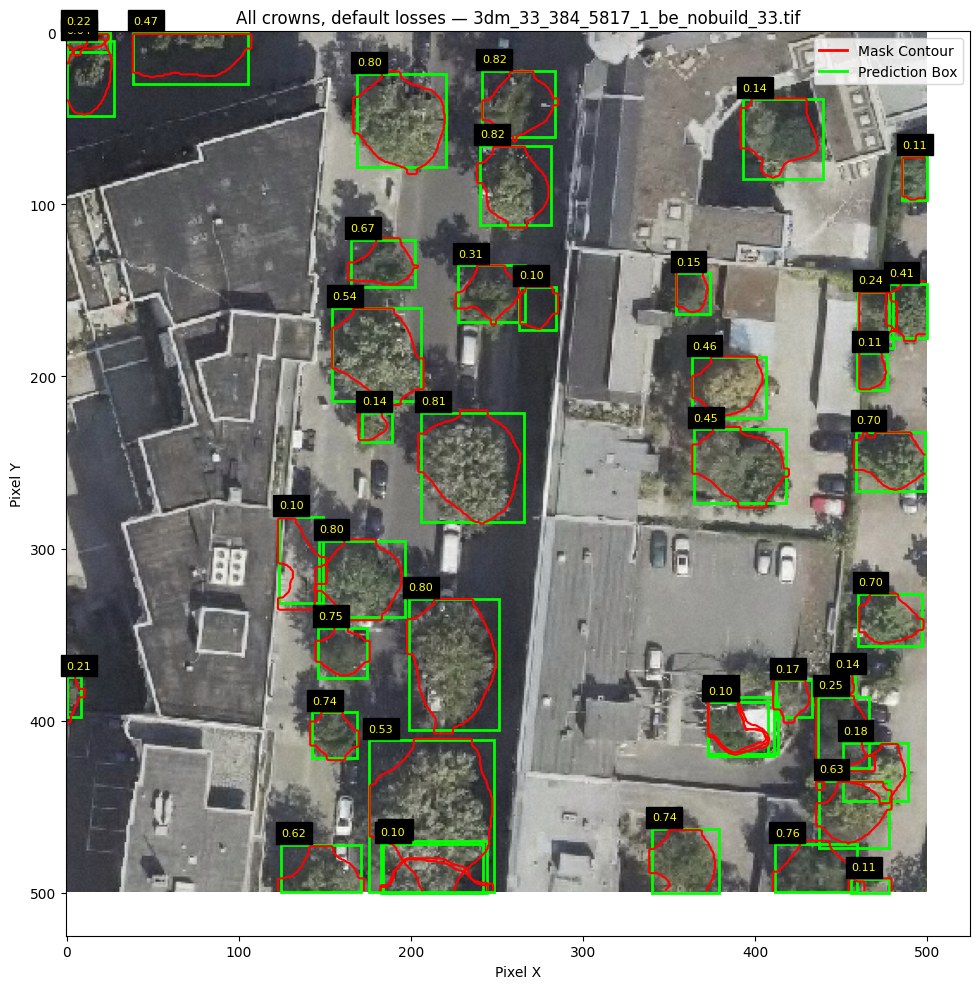

In [12]:
plot_prediction_img_coords(test_img, results)

In [13]:
from shapely.geometry import Polygon
from shapely.ops import unary_union

def compute_randcrowns(pred_poly, target_poly, alpha=0.7, omega=1.2, gamma=3.0):
    ra = target_poly.buffer(-alpha)
    ro = target_poly.buffer(omega)

    area_ra = ra.area
    area_rb = gamma * area_ra
    total_rb_area = area_rb + ro.area
    rb_radius_adjustment = ((total_rb_area / np.pi) ** 0.5) - (ro.bounds[2] - ro.bounds[0]) / 2
    rb = target_poly.buffer(omega + rb_radius_adjustment)

    a = pred_poly.intersection(ra).area
    b = rb.difference(pred_poly).area
    c = pred_poly.intersection(rb).area
    d = ra.difference(pred_poly).area

    denom = a + b + c + d
    return (a + b) / denom if denom > 0 else 0


def evaluate_randcrowns(preds, gts, iou_thresh=0.3):
    scores = []

    # Ensure geometries are valid
    preds = preds.copy()
    gts = gts.copy()
    preds['geometry'] = preds['geometry'].buffer(0)
    gts['geometry'] = gts['geometry'].buffer(0)

    for _, gt_row in gts.iterrows():
        gt_geom = gt_row.geometry
        best_score = 0

        for _, pred_row in preds.iterrows():
            pred_geom = pred_row.geometry

            if not pred_geom.is_valid or not gt_geom.is_valid or pred_geom.is_empty or gt_geom.is_empty:
                continue

            inter = pred_geom.intersection(gt_geom)
            union = pred_geom.union(gt_geom)

            if union.area > 0:
                iou_val = inter.area / union.area

                if iou_val > iou_thresh:
                    rc_score = compute_randcrowns(pred_geom, gt_geom)
                    if rc_score > best_score:
                        best_score = rc_score

        scores.append(best_score)

    return scores


In [14]:
# RandCrowns
single_test = evaluate_randcrowns(gdf_pred, gdf_gt, iou_thresh=0.3)
print(f"Mean RandCrowns: {np.mean(single_test):.3f}")
print(f"Std RandCrowns: {np.std(single_test):.3f}")


Mean RandCrowns: 0.522
Std RandCrowns: 0.307


Batch prediction

In [ ]:
tif_files = [f for f in os.listdir(raster_dir) if f.endswith(".tif")]
#selected_files = random.sample(tif_files, 10)
# = tif_files[:9]

all_predictions = []

In [16]:
selected_files = ["3dm_33_384_5817_1_be_nobuild_149.tif",
"3dm_33_384_5817_1_be_nobuild_85.tif",
"3dm_33_384_5817_1_be_nobuild_72.tif",
"3dm_33_384_5817_1_be_nobuild_59.tif",
"3dm_33_384_5817_1_be_nobuild_86.tif",
"3dm_33_385_5817_1_be_nobuild_122.tif",
"3dm_33_385_5817_1_be_nobuild_121.tif",
"3dm_33_385_5817_1_be_nobuild_22.tif",
"3dm_33_385_5817_1_be_nobuild_20.tif",
"3dm_33_385_5817_1_be_nobuild_23.tif"]



In [17]:
street_trees = [
    "3dm_33_384_5817_1_be_nobuild_149.tif",
    "3dm_33_384_5817_1_be_nobuild_59.tif",
    "3dm_33_385_5817_1_be_nobuild_22.tif",
    "3dm_33_385_5817_1_be_nobuild_20.tif",
    "3dm_33_385_5817_1_be_nobuild_23.tif"
]
park_trees = [
    "3dm_33_384_5817_1_be_nobuild_85.tif",
    "3dm_33_384_5817_1_be_nobuild_72.tif",
    "3dm_33_384_5817_1_be_nobuild_86.tif",
    "3dm_33_385_5817_1_be_nobuild_122.tif",
    "3dm_33_385_5817_1_be_nobuild_121.tif"
]


RandCrowns

In [ ]:
all_results = []
all_preds = []
all_gts = []
all_cadaster = []
all_results_detailed = []

# === Loop over selected rasters ===
for tif_file in selected_files:
    tile_name = tif_file.replace(".tif", "")
    raster_path = os.path.join(raster_dir, tif_file)
    print(f"\n🔍 Processing tile: {tile_name}")

    tile_row = tiles_gdf[tiles_gdf["tile_name"] == tile_name]
    if tile_row.empty:
        print("⚠️ Tile not found in tiles.geojson, skipping.")
        continue

    tile_geom = tile_row.geometry.values[0]
    crs = tiles_gdf.crs

    # Read raster
    with rasterio.open(raster_path) as src:
        img = src.read([1, 2, 3])
        img = np.moveaxis(img, 0, -1)
        transform = src.transform
        bounds = src.bounds
        shape = img.shape[:2]

    # Run YOLOv8 prediction
    results = model(raster_path, imgsz=640, conf=0.1, verbose=False)
    if results[0].masks is None:
        print("No masks found.")
        continue

    # Convert to polygons
    masks = results[0].masks.data.cpu().numpy()
    scores = results[0].boxes.conf.cpu().numpy()
    gdf_pred = masks_to_polygons(masks, original_bounds=bounds, out_shape=shape, scores=scores)
    gdf_pred["tile"] = tile_name
    gdf_pred = gpd.clip(gdf_pred, tile_geom)
    gdf_pred.set_crs(crs, inplace=True)
    all_preds.append(gdf_pred)

    # Save prediction
    output_path = f"/content/drive/MyDrive/masterthesis/predictions/{tile_name}_pred.geojson"
    os.makedirs(os.path.dirname(output_path), exist_ok=True)
    gdf_pred.to_file(output_path, driver="GeoJSON")
    print(f"✅ Saved predictions to {output_path}")

    # === Load ground truth ===
    gt_path = os.path.join(groundtruth_dir, f"{tile_name}.geojson")
    if not os.path.exists(gt_path):
        print(f"⚠️ Ground truth not found for {tile_name}, skipping.")
        continue

    gdf_gt = gpd.read_file(gt_path)
    gdf_gt = gdf_gt.set_crs(crs, allow_override=True)
    gdf_gt = gpd.clip(gdf_gt, tile_geom)
    all_gts.append(gdf_gt)

    # === Load cadaster buffer ===
    cadaster_path = os.path.join(cadaster_dir, f"{tile_name}.geojson")
    if not os.path.exists(cadaster_path):
        print(f"⚠️ Cadaster buffer not found for {tile_name}, skipping cadaster comparison.")
        gdf_cadaster = None
    else:
        gdf_cadaster = gpd.read_file(cadaster_path)
        gdf_cadaster = gdf_cadaster.set_crs(crs, allow_override=True)
        gdf_cadaster = gpd.clip(gdf_cadaster, tile_geom)
        all_cadaster.append(gdf_cadaster)

    # === Evaluate: Prediction vs Ground Truth ===
    scores_gt = evaluate_randcrowns(gdf_pred, gdf_gt, iou_thresh=0.3)
    mean_gt = float(np.mean(scores_gt)) if scores_gt else 0.0
    std_gt = float(np.std(scores_gt)) if scores_gt else 0.0

    # === Evaluate: Prediction vs Cadaster ===
    if gdf_cadaster is not None:
        scores_cadaster = evaluate_randcrowns(gdf_pred, gdf_cadaster, iou_thresh=0.3)
        mean_cad = float(np.mean(scores_cadaster)) if scores_cadaster else 0.0
        std_cad = float(np.std(scores_cadaster)) if scores_cadaster else 0.0
    else:
        scores_cadaster, mean_cad, std_cad = [], None, None

    # === Evaluate: Ground Truth vs Cadaster ===
    if gdf_cadaster is not None:
        scores_gt_cad = evaluate_randcrowns(gdf_gt, gdf_cadaster, iou_thresh=0.3)
        mean_gt_cad = float(np.mean(scores_gt_cad)) if scores_gt_cad else 0.0
        std_gt_cad = float(np.std(scores_gt_cad)) if scores_gt_cad else 0.0
    else:
        scores_gt_cad, mean_gt_cad, std_gt_cad = [], None, None

    # For GT vs Pred
    for idx, score in enumerate(scores_gt):
        all_results_detailed.append({
            "tile": tile_name,
            "type": "gt_vs_pred",
            "randcrowns": score,
            "pair_index": idx
        })

    # For Cadaster vs Pred
    for idx, score in enumerate(scores_cadaster):
        all_results_detailed.append({
            "tile": tile_name,
            "type": "cadaster_vs_pred",
            "randcrowns": score,
            "pair_index": idx
        })

    # For GT vs Cadaster
    for idx, score in enumerate(scores_gt_cad):
        all_results_detailed.append({
            "tile": tile_name,
            "type": "gt_vs_cadaster",
            "randcrowns": score,
            "pair_index": idx
        })


    # === Store results ===
    all_results.append({
        "tile": tile_name,
        "mean_randcrowns_gt": mean_gt,
        "std_randcrowns_gt": std_gt,
        "n_groundtruth": len(scores_gt),
        "mean_randcrowns_cadaster": mean_cad,
        "std_randcrowns_cadaster": std_cad,
        "n_cadaster": len(scores_cadaster) if gdf_cadaster is not None else 0,
        "mean_randcrowns_gt_cadaster": mean_gt_cad,
        "std_randcrowns_gt_cadaster": std_gt_cad,
        "n_predictions": len(gdf_pred)
    })

    print(f"Tile {tile_name}")
    print(f"  GT vs Pred:     Mean = {mean_gt:.3f}, Std = {std_gt:.3f}, N = {len(scores_gt)}")
    if mean_cad is not None:
        print(f"  Cad vs Pred:   Mean = {mean_cad:.3f}, Std = {std_cad:.3f}, N = {len(scores_cadaster)}")
        print(f"  GT vs Cad:     Mean = {mean_gt_cad:.3f}, Std = {std_gt_cad:.3f}, N = {len(scores_gt_cad)}")
    else:
        print("  Cadaster:      Skipped (no data)")


🔍 Processing tile: 3dm_33_384_5817_1_be_nobuild_149
✅ Saved predictions to /content/drive/MyDrive/masterthesis/predictions/3dm_33_384_5817_1_be_nobuild_149_pred.geojson
📊 Tile 3dm_33_384_5817_1_be_nobuild_149
  🟧 GT vs Pred:     Mean = 0.580, Std = 0.298, N = 15
  🟦 Cad vs Pred:   Mean = 0.656, Std = 0.231, N = 13
  🟨 GT vs Cad:     Mean = 0.628, Std = 0.296, N = 13

🔍 Processing tile: 3dm_33_384_5817_1_be_nobuild_85
✅ Saved predictions to /content/drive/MyDrive/masterthesis/predictions/3dm_33_384_5817_1_be_nobuild_85_pred.geojson
📊 Tile 3dm_33_384_5817_1_be_nobuild_85
  🟧 GT vs Pred:     Mean = 0.596, Std = 0.274, N = 31
  🟦 Cad vs Pred:   Mean = 0.421, Std = 0.376, N = 83
  🟨 GT vs Cad:     Mean = 0.383, Std = 0.391, N = 83

🔍 Processing tile: 3dm_33_384_5817_1_be_nobuild_72
✅ Saved predictions to /content/drive/MyDrive/masterthesis/predictions/3dm_33_384_5817_1_be_nobuild_72_pred.geojson
📊 Tile 3dm_33_384_5817_1_be_nobuild_72
  🟧 GT vs Pred:     Mean = 0.623, Std = 0.279, N = 20
  

In [19]:
print(all_results)

[{'tile': '3dm_33_384_5817_1_be_nobuild_149', 'mean_randcrowns_gt': 0.5801863961990728, 'std_randcrowns_gt': 0.2980106670061983, 'n_groundtruth': 15, 'mean_randcrowns_cadaster': 0.6556218050532585, 'std_randcrowns_cadaster': 0.23065766577379362, 'n_cadaster': 13, 'mean_randcrowns_gt_cadaster': 0.6280826295503998, 'std_randcrowns_gt_cadaster': 0.2960966334889109, 'n_predictions': 15}, {'tile': '3dm_33_384_5817_1_be_nobuild_85', 'mean_randcrowns_gt': 0.5956830082205545, 'std_randcrowns_gt': 0.2738765429375212, 'n_groundtruth': 31, 'mean_randcrowns_cadaster': 0.4212238127947071, 'std_randcrowns_cadaster': 0.3758981869662631, 'n_cadaster': 83, 'mean_randcrowns_gt_cadaster': 0.38329591385320816, 'std_randcrowns_gt_cadaster': 0.39111445516698495, 'n_predictions': 37}, {'tile': '3dm_33_384_5817_1_be_nobuild_72', 'mean_randcrowns_gt': 0.6228672227829741, 'std_randcrowns_gt': 0.2794956654026861, 'n_groundtruth': 20, 'mean_randcrowns_cadaster': 0.4358384266268603, 'std_randcrowns_cadaster': 0.36

In [20]:
df_summary = pd.DataFrame(all_results)

# Save
df_summary.to_csv(f"/content/drive/MyDrive/masterthesis/predictions/{model_name}_randcrowns_summary.csv", index=False)

# View
print(df_summary)

                               tile  mean_randcrowns_gt  std_randcrowns_gt  \
0  3dm_33_384_5817_1_be_nobuild_149            0.580186           0.298011   
1   3dm_33_384_5817_1_be_nobuild_85            0.595683           0.273877   
2   3dm_33_384_5817_1_be_nobuild_72            0.622867           0.279496   
3   3dm_33_384_5817_1_be_nobuild_59            0.593246           0.302040   
4   3dm_33_384_5817_1_be_nobuild_86            0.544676           0.321736   
5  3dm_33_385_5817_1_be_nobuild_122            0.679003           0.265022   
6  3dm_33_385_5817_1_be_nobuild_121            0.554405           0.305285   
7   3dm_33_385_5817_1_be_nobuild_22            0.499110           0.355531   
8   3dm_33_385_5817_1_be_nobuild_20            0.656698           0.247790   
9   3dm_33_385_5817_1_be_nobuild_23            0.479602           0.320707   

   n_groundtruth  mean_randcrowns_cadaster  std_randcrowns_cadaster  \
0             15                  0.655622                 0.230658   

In [21]:
results_df = pd.DataFrame(all_results)
results_detailed_df = pd.DataFrame(all_results_detailed)

/tmp/ipython-input-3656805625.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=results_detailed_df, x="type", y="randcrowns", palette="Set2")


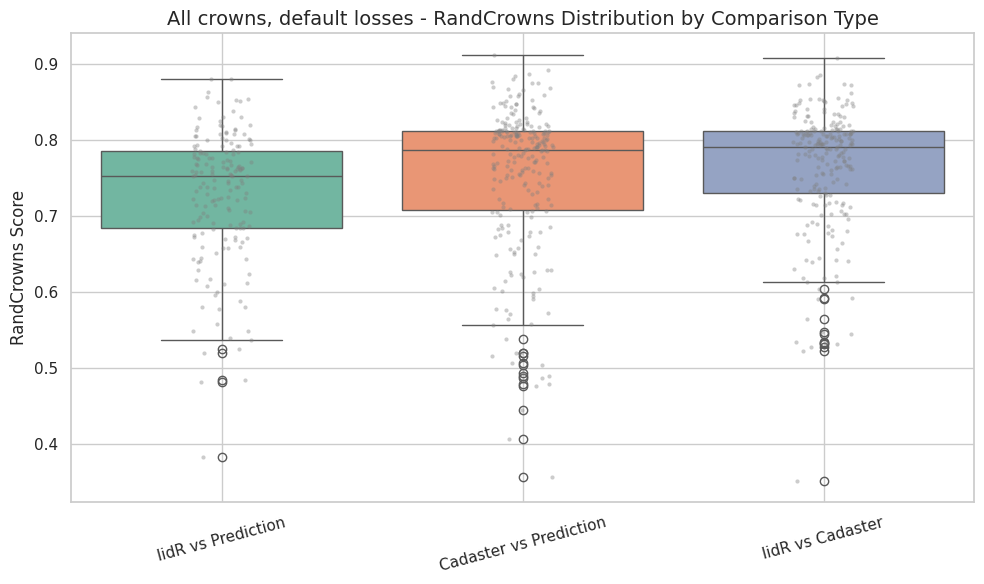

In [22]:
results_detailed_df = results_detailed_df[results_detailed_df["randcrowns"] > 0]

# Map nicer labels
results_detailed_df["type"] = results_detailed_df["type"].map({
    "gt_vs_pred": "lidR vs Prediction",
    "cadaster_vs_pred": "Cadaster vs Prediction",
    "gt_vs_cadaster": "lidR vs Cadaster"
})

# Set plot style
sns.set(style="whitegrid")

# Create boxplot
plt.figure(figsize=(10, 6))
sns.boxplot(data=results_detailed_df, x="type", y="randcrowns", palette="Set2")

# Add jittered points for visibility
sns.stripplot(data=results_detailed_df, x="type", y="randcrowns",
              color="gray", size=3, alpha=0.4, jitter=True)

# Labels and title
plt.title(f"{model_label} - RandCrowns Distribution by Comparison Type", fontsize=14)
plt.ylabel("RandCrowns Score", fontsize=12)
plt.xlabel("", fontsize=12)
plt.xticks(rotation=15)
plt.grid(True)
plt.tight_layout()
plt.show()


In [23]:
# Group by comparison type and calculate mean + median
summary_stats = results_detailed_df.groupby("type")["randcrowns"].agg(['mean', 'median', 'std']).reset_index()

# Round for readability
summary_stats[["mean", "median", "std"]] = summary_stats[["mean", "median", "std"]].round(3)

# Display the results
print("📊 RandCrowns Summary (Filtered > 0):")
print(summary_stats)


📊 RandCrowns Summary (Filtered > 0):
                     type   mean  median    std
0  Cadaster vs Prediction  0.751   0.787  0.100
1        lidR vs Cadaster  0.764   0.790  0.081
2      lidR vs Prediction  0.728   0.752  0.086


/tmp/ipython-input-1688301449.py:23: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x="Reference", y="RandCrowns Score", data=melted, palette="Set2")


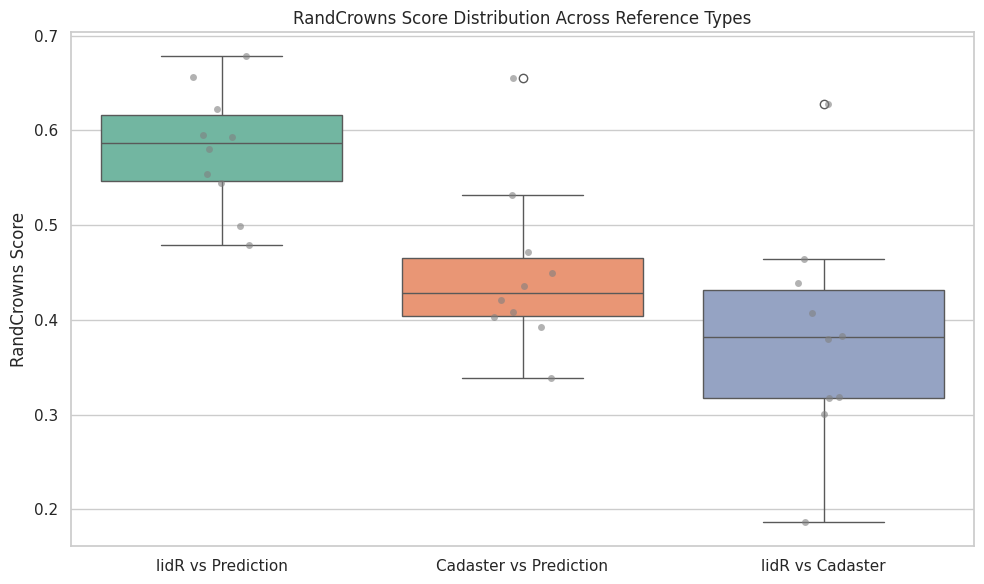

In [24]:
# Prepare melted DataFrame for all three comparisons
melted = pd.melt(
    results_df,
    id_vars=["tile"],
    value_vars=[
        "mean_randcrowns_gt",
        "mean_randcrowns_cadaster",
        "mean_randcrowns_gt_cadaster"
    ],
    var_name="Reference",
    value_name="RandCrowns Score"
)

# Map column names to readable labels
melted["Reference"] = melted["Reference"].map({
    "mean_randcrowns_gt": "lidR vs Prediction",
    "mean_randcrowns_cadaster": "Cadaster vs Prediction",
    "mean_randcrowns_gt_cadaster": "lidR vs Cadaster"
})

# Plot
plt.figure(figsize=(10, 6))
sns.boxplot(x="Reference", y="RandCrowns Score", data=melted, palette="Set2")
sns.stripplot(x="Reference", y="RandCrowns Score", data=melted, color="gray", alpha=0.6, jitter=True)
plt.title("RandCrowns Score Distribution Across Reference Types")
plt.ylabel("RandCrowns Score")
plt.xlabel("")
plt.grid(True, axis='y')
plt.tight_layout()
plt.show()

Total Counts:
Ground Truth: 214
Cadaster: 433
Predictions: 315

Deviation from Cadaster:
Ground Truth: -219
Predictions: -118


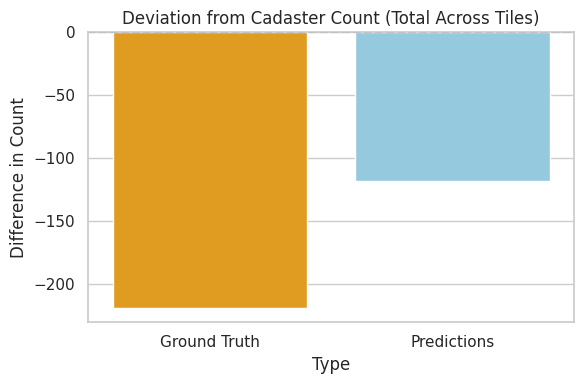

In [25]:
# Calculate overall sums
sums = results_df[["n_groundtruth", "n_cadaster", "n_predictions"]].sum()

# Print the total counts
print("Total Counts:")
print(f"Ground Truth: {sums['n_groundtruth']}")
print(f"Cadaster: {sums['n_cadaster']}")
print(f"Predictions: {sums['n_predictions']}")
print()

# Compute deviation from cadaster
deviation_df = pd.DataFrame({
    "Type": ["Ground Truth", "Predictions"],
    "Deviation from Cadaster": [
        sums["n_groundtruth"] - sums["n_cadaster"],
        sums["n_predictions"] - sums["n_cadaster"]
    ]
})

# Print deviations
print("Deviation from Cadaster:")
for index, row in deviation_df.iterrows():
    print(f"{row['Type']}: {row['Deviation from Cadaster']}")

# Plot deviations (fixing the palette deprecation warning)
plt.figure(figsize=(6, 4))
sns.barplot(
    data=deviation_df,
    x="Type",
    y="Deviation from Cadaster",
    hue="Type",
    palette=["orange", "skyblue"],
    legend=False  # prevent duplicate legend
)
plt.axhline(0, color="gray", linestyle="--")
plt.title("Deviation from Cadaster Count (Total Across Tiles)")
plt.ylabel("Difference in Count")
plt.tight_layout()
plt.show()


Total Counts:
Ground Truth (lidR): 214
Cadaster: 433
Predictions: 315

Deviation from Cadaster (%):
lidR: -50.58%
Predictions: -27.25%



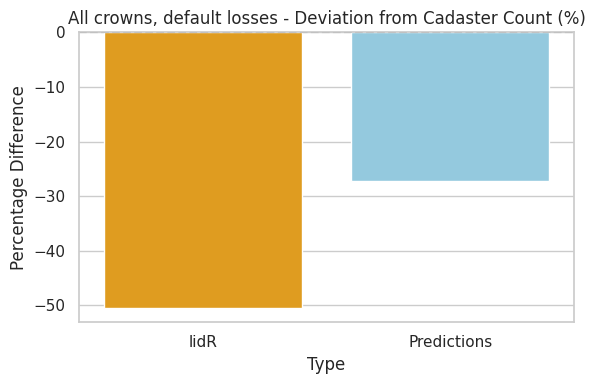

In [26]:
# Calculate overall sums
sums = results_df[["n_groundtruth", "n_cadaster", "n_predictions"]].sum()

# Print the total counts
print("Total Counts:")
print(f"Ground Truth (lidR): {sums['n_groundtruth']}")
print(f"Cadaster: {sums['n_cadaster']}")
print(f"Predictions: {sums['n_predictions']}")
print()

# Avoid division by zero
cadaster_total = sums["n_cadaster"] if sums["n_cadaster"] != 0 else 1

# Compute deviation as percentage of cadaster
deviation_df = pd.DataFrame({
    "Type": ["lidR", "Predictions"],
    "Deviation from Cadaster (%)": [
        100 * (sums["n_groundtruth"] - sums["n_cadaster"]) / cadaster_total,
        100 * (sums["n_predictions"] - sums["n_cadaster"]) / cadaster_total
    ]
})

# Print deviations in percentage
print("Deviation from Cadaster (%):")
for index, row in deviation_df.iterrows():
    print(f"{row['Type']}: {row['Deviation from Cadaster (%)']:.2f}%")
print()

# Plot deviations (fixing the palette deprecation warning)
plt.figure(figsize=(6, 4))
sns.barplot(
    data=deviation_df,
    x="Type",
    y="Deviation from Cadaster (%)",
    hue="Type",
    palette=["orange", "skyblue"],
    legend=False
)
plt.axhline(0, color="gray", linestyle="--")
plt.title(f"{model_label} - Deviation from Cadaster Count (%)")
plt.ylabel("Percentage Difference")
plt.tight_layout()
plt.show()


In [27]:
results_df["groundtruth_dev_abs"] = results_df["n_groundtruth"] - results_df["n_cadaster"]
results_df["predictions_dev_abs"] = results_df["n_predictions"] - results_df["n_cadaster"]

results_df["groundtruth_dev_rel"] = 100 * results_df["groundtruth_dev_abs"] / results_df["n_cadaster"].replace(0, np.nan)
results_df["predictions_dev_rel"] = 100 * results_df["predictions_dev_abs"] / results_df["n_cadaster"].replace(0, np.nan)


In [28]:
# Check the extreme values
print("Predictions deviation (absolute):")
print(f"Min: {results_df['predictions_dev_abs'].min()}")
print(f"Max: {results_df['predictions_dev_abs'].max()}")
print(f"Mean: {results_df['predictions_dev_abs'].mean():.2f}")
print(f"Median: {results_df['predictions_dev_abs'].median():.2f}")

print("\nPredictions deviation (relative %):")
print(f"Min: {results_df['predictions_dev_rel'].min():.1f}%")
print(f"Max: {results_df['predictions_dev_rel'].max():.1f}%")

Predictions deviation (absolute):
Min: -46
Max: 17
Mean: -11.80
Median: -18.00

Predictions deviation (relative %):
Min: -55.4%
Max: 188.9%


In [29]:
results_df.head()

,tile,mean_randcrowns_gt,std_randcrowns_gt,n_groundtruth,mean_randcrowns_cadaster,std_randcrowns_cadaster,n_cadaster,mean_randcrowns_gt_cadaster,std_randcrowns_gt_cadaster,n_predictions,groundtruth_dev_abs,predictions_dev_abs,groundtruth_dev_rel,predictions_dev_rel
0,3dm_33_384_5817_1_be_nobuild_149,0.580186,0.298011,15,0.655622,0.230658,13,0.628083,0.296097,15,2,2,15.384615,15.384615
1,3dm_33_384_5817_1_be_nobuild_85,0.595683,0.273877,31,0.421224,0.375898,83,0.383296,0.391114,37,-52,-46,-62.650602,-55.421687
2,3dm_33_384_5817_1_be_nobuild_72,0.622867,0.279496,20,0.435838,0.364093,55,0.379890,0.377187,35,-35,-20,-63.636364,-36.363636
3,3dm_33_384_5817_1_be_nobuild_59,0.593246,0.302040,20,0.471481,0.377702,44,0.464537,0.372865,49,-24,5,-54.545455,11.363636
4,3dm_33_384_5817_1_be_nobuild_86,0.544676,0.321736,28,0.392017,0.381695,71,0.438944,0.381214,41,-43,-30,-60.563380,-42.253521


In [30]:
# Flexible matching function
def classify_tree(tile):
    if any(tile in tree_filename for tree_filename in street_trees):
        return "Street Tree"
    elif any(tile in tree_filename for tree_filename in park_trees):
        return "Park Tree"
    else:
        return "Unknown"

# Apply classification to the dataframe
results_df['tree_type'] = results_df['tile'].apply(classify_tree)

# Optionally, verify the counts
print(results_df['tree_type'].value_counts())

tree_type
Street Tree    5
Park Tree      5
Name: count, dtype: int64


Deviation from Cadaster (%) per Tree Type:
     Tree Type       Source  Deviation from Cadaster (%)
0    Park Tree         lidR                   -60.269360
1    Park Tree  Predictions                   -44.444444
2  Street Tree         lidR                   -29.411765
3  Street Tree  Predictions                    10.294118


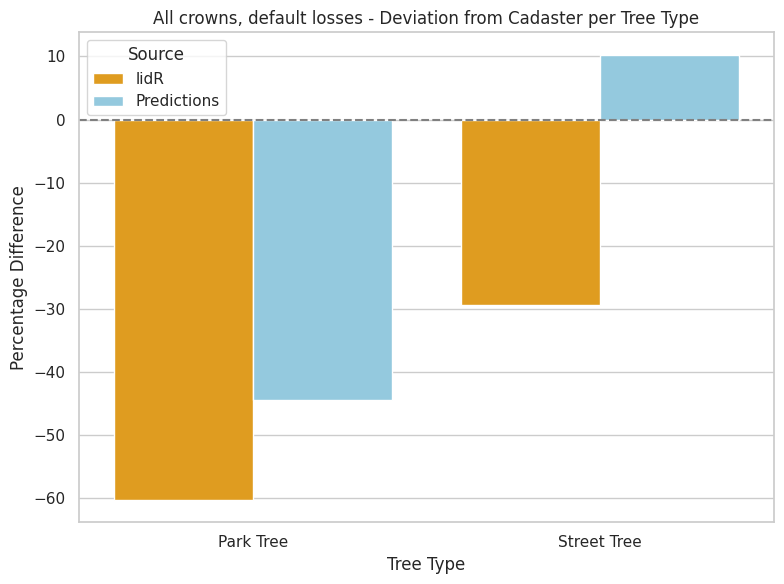

In [31]:
# First: Group by tree type and calculate sums per group
group_sums = results_df.groupby('tree_type')[['n_groundtruth', 'n_cadaster', 'n_predictions']].sum().reset_index()

# Initialize a list to store deviations per tree type
deviation_records = []

# Calculate deviations for each tree type
for idx, row in group_sums.iterrows():
    cadaster_total = row['n_cadaster'] if row['n_cadaster'] != 0 else 1  # Avoid division by zero

    deviation_records.append({
        'Tree Type': row['tree_type'],
        'Source': 'lidR',
        'Deviation from Cadaster (%)': 100 * (row['n_groundtruth'] - row['n_cadaster']) / cadaster_total
    })
    deviation_records.append({
        'Tree Type': row['tree_type'],
        'Source': 'Predictions',
        'Deviation from Cadaster (%)': 100 * (row['n_predictions'] - row['n_cadaster']) / cadaster_total
    })

# Create dataframe for deviations per tree type
deviation_per_type_df = pd.DataFrame(deviation_records)

# Print per tree type deviations
print("Deviation from Cadaster (%) per Tree Type:")
print(deviation_per_type_df)

# Plot deviations per tree type
plt.figure(figsize=(8, 6))
sns.barplot(
    data=deviation_per_type_df,
    x='Tree Type',
    y='Deviation from Cadaster (%)',
    hue='Source',
    palette=['orange', 'skyblue']
)
plt.axhline(0, color="gray", linestyle="--")
plt.title(f"{model_label} - Deviation from Cadaster per Tree Type")
plt.ylabel("Percentage Difference")
plt.tight_layout()
plt.show()


In [32]:
avg_n_cadaster = results_df["n_cadaster"].mean().round(2)
avg_n_groundtruth = results_df["n_groundtruth"].mean().round(2)
avg_n_predictions = results_df["n_predictions"].mean().round(2)

print(avg_n_cadaster)
print(avg_n_groundtruth)
print(avg_n_predictions)

43.3
21.4
31.5


In [33]:
avg_abs_dev_gt = results_df["groundtruth_dev_abs"].mean().round(2)
avg_abs_dev_pred = results_df["predictions_dev_abs"].mean().round(2)

avg_rel_dev_gt = results_df["groundtruth_dev_rel"].mean().round(2)
avg_rel_dev_pred = results_df["predictions_dev_rel"].mean().round(2)

print(f"📦 On average per tile:")
print(f"🔸 lidR is {avg_abs_dev_gt:+} crowns ({avg_rel_dev_gt:+}% deviation from cadaster)")
print(f"🔹 Predictions are {avg_abs_dev_pred:+} crowns ({avg_rel_dev_pred:+}% deviation from cadaster)")


📦 On average per tile:
🔸 lidR is -21.9 crowns (-24.44% deviation from cadaster)
🔹 Predictions are -11.8 crowns (+5.69% deviation from cadaster)


In [34]:
def compute_iou_metrics(preds, gts, iou_thresh=0.5):
    preds = preds.copy()
    gts = gts.copy()
    preds['matched'] = False
    gts['matched'] = False

    tp = 0
    for pred_idx, pred_row in preds.iterrows():
        best_iou = 0
        best_gt_idx = None
        for gt_idx, gt_row in gts.iterrows():
            if gts.at[gt_idx, 'matched']:
                continue
            iou = pred_row.geometry.intersection(gt_row.geometry).area / \
                  pred_row.geometry.union(gt_row.geometry).area
            if iou > best_iou:
                best_iou = iou
                best_gt_idx = gt_idx
        if best_iou >= iou_thresh:
            tp += 1
            preds.at[pred_idx, 'matched'] = True
            gts.at[best_gt_idx, 'matched'] = True

    fp = (~preds['matched']).sum()
    fn = (~gts['matched']).sum()
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0.0
    recall = tp / (tp + fn) if (tp + fn) > 0 else 0.0

    return {
        "TP": tp,
        "FP": int(fp),
        "FN": int(fn),
        "Precision": precision,
        "Recall": recall
    }


In [35]:
def compute_precision_recall_iou_range(preds, gts, iou_thresholds=np.arange(0.5, 1.0, 0.05)):
    ap_results = []

    for iou_thresh in iou_thresholds:
        metrics = compute_iou_metrics(preds, gts, iou_thresh=iou_thresh)
        ap_results.append({
            "IoU": round(iou_thresh, 2),
            "Precision": metrics["Precision"],
            "Recall": metrics["Recall"],
            "TP": metrics["TP"],
            "FP": metrics["FP"],
            "FN": metrics["FN"]
        })

    return pd.DataFrame(ap_results)


In [36]:
# Prepare unified GeoDataFrames
all_preds_df = gpd.GeoDataFrame(pd.concat(all_preds, ignore_index=True)).set_crs(crs)
all_gts_df = gpd.GeoDataFrame(pd.concat(all_gts, ignore_index=True)).set_crs(crs)
all_cadaster_df = gpd.GeoDataFrame(pd.concat(all_cadaster, ignore_index=True)).set_crs(crs)

# === Utility to compute AP at specific IoU ===
def compute_ap_at_iou(ap_table, iou_val):
    row = ap_table[ap_table["IoU"] == iou_val]
    return row["Precision"].values[0] if not row.empty else 0.0

def compute_recall_at_iou(ap_table, iou_val):
    row = ap_table[ap_table["IoU"] == iou_val]
    return row["Recall"].values[0] if not row.empty else 0.0


# === GT <> PREDICTION ===
ap_table_gt_to_pred = compute_precision_recall_iou_range(all_preds_df, all_gts_df)
ap50_gt = compute_ap_at_iou(ap_table_gt_to_pred, 0.5)
ap75_gt = compute_ap_at_iou(ap_table_gt_to_pred, 0.75)
map_gt = np.mean([ap50_gt, ap75_gt])
recall50_gt = compute_recall_at_iou(ap_table_gt_to_pred, 0.5)
recall75_gt = compute_recall_at_iou(ap_table_gt_to_pred, 0.75)

print("\n📊 GT <> Prediction")
print(f"🔹 AP@0.5: {ap50_gt:.3f}")
print(f"🔸 AP@0.75: {ap75_gt:.3f}")
print(f"🔥 mAP@[.5, .75]: {map_gt:.3f}")
print(f"📥 Recall@0.5: {recall50_gt:.3f}")
print(f"📥 Recall@0.75: {recall75_gt:.3f}")

# === CADASTER <> PREDICTION ===
ap_table_cad_to_pred = compute_precision_recall_iou_range(all_preds_df, all_cadaster_df)
ap50_cad = compute_ap_at_iou(ap_table_cad_to_pred, 0.5)
ap75_cad = compute_ap_at_iou(ap_table_cad_to_pred, 0.75)
map_cad = np.mean([ap50_cad, ap75_cad])
recall50_cad = compute_recall_at_iou(ap_table_cad_to_pred, 0.5)
recall75_cad = compute_recall_at_iou(ap_table_cad_to_pred, 0.75)

print("\n📊 Cadaster <> Prediction")
print(f"🔹 AP@0.5: {ap50_cad:.3f}")
print(f"🔸 AP@0.75: {ap75_cad:.3f}")
print(f"🔥 mAP@[.5, .75]: {map_cad:.3f}")
print(f"📥 Recall@0.5: {recall50_cad:.3f}")
print(f"📥 Recall@0.75: {recall75_cad:.3f}")

# === CADASTER <> GROUND TRUTH ===
ap_table_cad_to_gt = compute_precision_recall_iou_range(all_cadaster_df, all_gts_df)
ap50_cad_gt = compute_ap_at_iou(ap_table_cad_to_gt, 0.5)
ap75_cad_gt = compute_ap_at_iou(ap_table_cad_to_gt, 0.75)
map_cad_gt = np.mean([ap50_cad_gt, ap75_cad_gt])
recall50_cad_gt = compute_recall_at_iou(ap_table_cad_to_gt, 0.5)
recall75_cad_gt = compute_recall_at_iou(ap_table_cad_to_gt, 0.75)


print("\n📊 Cadaster <> Ground Truth")
print(f"🔹 AP@0.5: {ap50_cad_gt:.3f}")
print(f"🔸 AP@0.75: {ap75_cad_gt:.3f}")
print(f"🔥 mAP@[.5, .75]: {map_cad_gt:.3f}")
print(f"📥 Recall@0.5: {recall50_cad_gt:.3f}")
print(f"📥 Recall@0.75: {recall75_cad_gt:.3f}")


📊 GT <> Prediction
🔹 AP@0.5: 0.403
🔸 AP@0.75: 0.076
🔥 mAP@[.5, .75]: 0.240
📥 Recall@0.5: 0.593
📥 Recall@0.75: 0.112

📊 Cadaster <> Prediction
🔹 AP@0.5: 0.333
🔸 AP@0.75: 0.032
🔥 mAP@[.5, .75]: 0.183
📥 Recall@0.5: 0.242
📥 Recall@0.75: 0.023

📊 Cadaster <> Ground Truth
🔹 AP@0.5: 0.187
🔸 AP@0.75: 0.023
🔥 mAP@[.5, .75]: 0.105
📥 Recall@0.5: 0.379
📥 Recall@0.75: 0.047


In [37]:
# === Collect metrics into a DataFrame for plotting ===
metrics_summary = pd.DataFrame([
    {
        "Comparison": "lidR to Prediction",
        "AP@0.5": ap50_gt,
        "AP@0.75": ap75_gt,
        "mAP@[.5,.75]": map_gt,
        "Recall@0.5": recall50_gt,
        "Recall@0.75": recall75_gt
    },
    {
        "Comparison": "Cadaster to Prediction",
        "AP@0.5": ap50_cad,
        "AP@0.75": ap75_cad,
        "mAP@[.5,.75]": map_cad,
        "Recall@0.5": recall50_cad,
        "Recall@0.75": recall75_cad
    },
    {
        "Comparison": "Cadaster to lidR",
        "AP@0.5": ap50_cad_gt,
        "AP@0.75": ap75_cad_gt,
        "mAP@[.5,.75]": map_cad_gt,
        "Recall@0.5": recall50_cad_gt,
        "Recall@0.75": recall75_cad_gt
    }
])

# Optional: Display the summary
print(metrics_summary)


               Comparison    AP@0.5   AP@0.75  mAP@[.5,.75]  Recall@0.5  \
0      lidR to Prediction  0.403175  0.076190      0.239683    0.593458   
1  Cadaster to Prediction  0.333333  0.031746      0.182540    0.242494   
2        Cadaster to lidR  0.187067  0.023095      0.105081    0.378505   

   Recall@0.75  
0     0.112150  
1     0.023095  
2     0.046729  


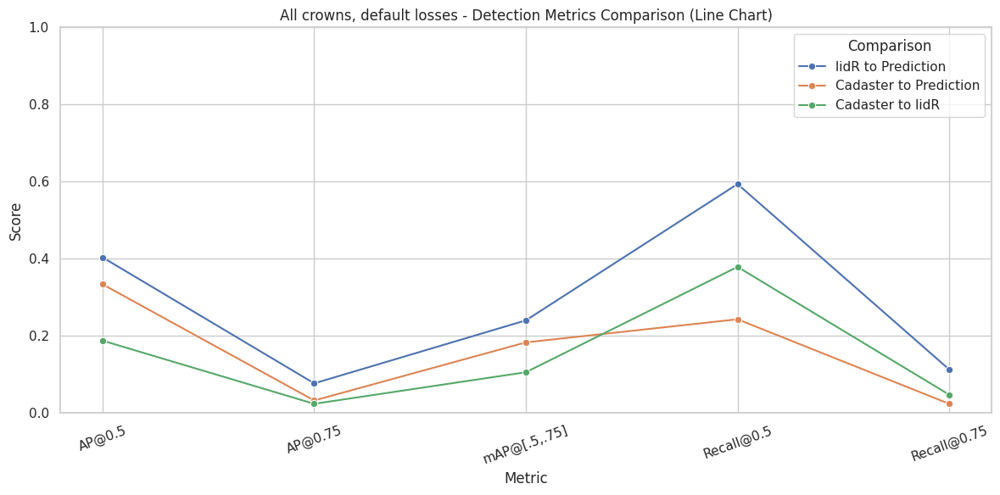

In [38]:
# Melt the DataFrame for plotting
melted = metrics_summary.melt(id_vars="Comparison", var_name="Metric", value_name="Score")

# Create the line plot
plt.figure(figsize=(12, 6))
sns.lineplot(data=melted, x="Metric", y="Score", hue="Comparison", marker="o")

plt.title(f"{model_label} - Detection Metrics Comparison (Line Chart)")
plt.xlabel("Metric")
plt.ylabel("Score")
plt.ylim(0, 1)
plt.grid(True, axis="y")
plt.xticks(rotation=20)
plt.tight_layout()
plt.show()

In [39]:
def compute_average_precision(preds, gts, iou_thresh=0.5):
    """
    Computes average precision (AP), precision, recall, TP, FP, FN
    based on IoU threshold for instance segmentation,
    and prints out the confidence threshold used for each prediction.
    """
    # Sort predictions by confidence
    preds_sorted = preds.sort_values("confidence", ascending=False).reset_index(drop=True)
    gts = gts.copy()
    matched_gt = set()
    tp = []
    fp = []

    print(f"IoU threshold = {iou_thresh}\n")

    for idx, pred_row in preds_sorted.iterrows():
        conf_score = pred_row["confidence"]
        pred_geom = pred_row.geometry
        best_iou = 0
        best_gt_idx = None

        # find best-matching GT
        for gt_idx, gt_row in gts.iterrows():
            if gt_idx in matched_gt:
                continue

            inter = pred_geom.intersection(gt_row.geometry).area
            union = pred_geom.union(gt_row.geometry).area
            iou = inter / union if union > 0 else 0

            if iou > best_iou:
                best_iou = iou
                best_gt_idx = gt_idx

        # decide TP / FP
        is_tp = best_iou >= iou_thresh
        tp.append(1 if is_tp else 0)
        fp.append(0 if is_tp else 1)
        if is_tp:
            matched_gt.add(best_gt_idx)

        # print the “threshold” and outcome
        outcome = "TP" if is_tp else "FP"
        print(f"#{idx+1}: conf ≥ {conf_score:.3f} → best IoU {best_iou:.3f} → {outcome}")

    # rest is unchanged…
    tp_cum = np.cumsum(tp)
    fp_cum = np.cumsum(fp)
    recalls = tp_cum / len(gts) if len(gts) > 0 else np.zeros_like(tp_cum)
    precisions = tp_cum / (tp_cum + fp_cum + 1e-8)
    ap = np.trapz(precisions, recalls)

    return {
        "AP": ap,
        "Precision": float(precisions[-1]) if len(precisions) else 0.0,
        "Recall": float(recalls[-1]) if len(recalls) else 0.0,
        "TP": int(tp_cum[-1]) if len(tp_cum) else 0,
        "FP": int(fp_cum[-1]) if len(fp_cum) else 0,
        "FN": len(gts) - int(tp_cum[-1]) if len(gts) else 0
    }


In [40]:
iou_thresh = 0.3  # or loop over multiple thresholds if needed

# Get TP, FP, FN from a final aggregated call
summary_gt = compute_average_precision(all_preds_df, all_gts_df, iou_thresh=iou_thresh)

summary_cadaster = compute_average_precision(all_preds_df, all_cadaster_df, iou_thresh=iou_thresh)


# Example output dict structure:
# summary = {"TP": ..., "FP": ..., "FN": ..., "Precision": ..., "Recall": ..., "AP": ...}


IoU threshold = 0.3

#1: conf ≥ 0.886 → best IoU 0.789 → TP
#2: conf ≥ 0.855 → best IoU 0.736 → TP
#3: conf ≥ 0.853 → best IoU 0.751 → TP
#4: conf ≥ 0.849 → best IoU 0.675 → TP
#5: conf ≥ 0.845 → best IoU 0.356 → TP
#6: conf ≥ 0.837 → best IoU 0.768 → TP
#7: conf ≥ 0.834 → best IoU 0.000 → FP
#8: conf ≥ 0.828 → best IoU 0.837 → TP
#9: conf ≥ 0.823 → best IoU 0.000 → FP
#10: conf ≥ 0.821 → best IoU 0.759 → TP
#11: conf ≥ 0.817 → best IoU 0.779 → TP
#12: conf ≥ 0.817 → best IoU 0.780 → TP
#13: conf ≥ 0.816 → best IoU 0.674 → TP
#14: conf ≥ 0.810 → best IoU 0.725 → TP
#15: conf ≥ 0.810 → best IoU 0.752 → TP
#16: conf ≥ 0.810 → best IoU 0.757 → TP
#17: conf ≥ 0.809 → best IoU 0.812 → TP
#18: conf ≥ 0.808 → best IoU 0.497 → TP
#19: conf ≥ 0.803 → best IoU 0.760 → TP
#20: conf ≥ 0.803 → best IoU 0.656 → TP
#21: conf ≥ 0.798 → best IoU 0.000 → FP
#22: conf ≥ 0.797 → best IoU 0.744 → TP
#23: conf ≥ 0.794 → best IoU 0.695 → TP
#24: conf ≥ 0.792 → best IoU 0.508 → TP
#25: conf ≥ 0.787 → best IoU

/tmp/ipython-input-3229791875.py:51: DeprecationWarning: `trapz` is deprecated. Use `trapezoid` instead, or one of the numerical integration functions in `scipy.integrate`.
  ap = np.trapz(precisions, recalls)


#2: conf ≥ 0.855 → best IoU 0.229 → FP
#3: conf ≥ 0.853 → best IoU 0.623 → TP
#4: conf ≥ 0.849 → best IoU 0.770 → TP
#5: conf ≥ 0.845 → best IoU 0.504 → TP
#6: conf ≥ 0.837 → best IoU 0.532 → TP
#7: conf ≥ 0.834 → best IoU 0.455 → TP
#8: conf ≥ 0.828 → best IoU 0.185 → FP
#9: conf ≥ 0.823 → best IoU 0.609 → TP
#10: conf ≥ 0.821 → best IoU 0.818 → TP
#11: conf ≥ 0.817 → best IoU 0.539 → TP
#12: conf ≥ 0.817 → best IoU 0.831 → TP
#13: conf ≥ 0.816 → best IoU 0.685 → TP
#14: conf ≥ 0.810 → best IoU 0.000 → FP
#15: conf ≥ 0.810 → best IoU 0.183 → FP
#16: conf ≥ 0.810 → best IoU 0.559 → TP
#17: conf ≥ 0.809 → best IoU 0.735 → TP
#18: conf ≥ 0.808 → best IoU 0.584 → TP
#19: conf ≥ 0.803 → best IoU 0.583 → TP
#20: conf ≥ 0.803 → best IoU 0.434 → TP
#21: conf ≥ 0.798 → best IoU 0.731 → TP
#22: conf ≥ 0.797 → best IoU 0.680 → TP
#23: conf ≥ 0.794 → best IoU 0.624 → TP
#24: conf ≥ 0.792 → best IoU 0.259 → FP
#25: conf ≥ 0.787 → best IoU 0.000 → FP
#26: conf ≥ 0.784 → best IoU 0.423 → TP
#27: con

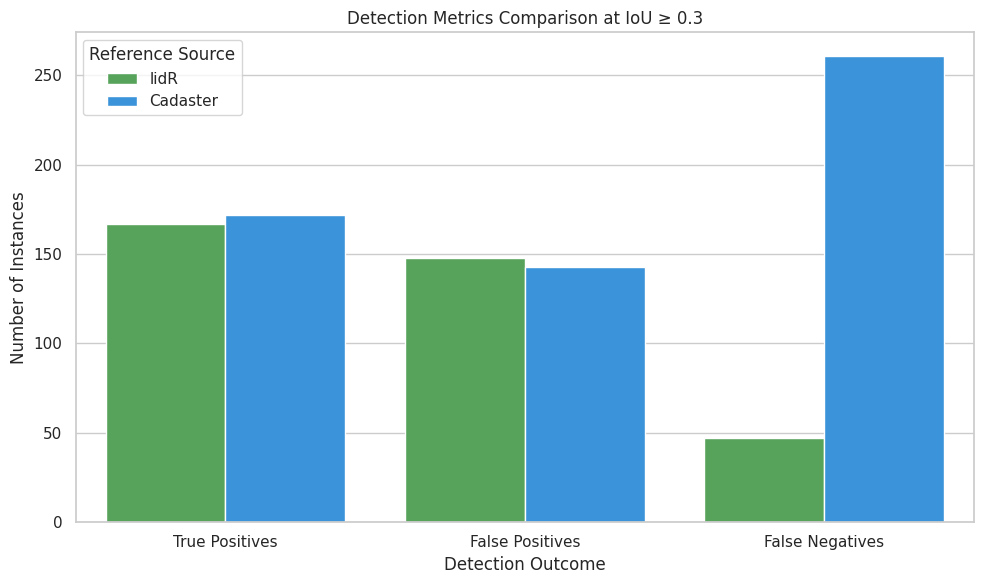

In [41]:
# Combine into a DataFrame
metrics_data = pd.DataFrame([
    {"Source": "lidR", "Category": "True Positives", "Count": summary_gt["TP"]},
    {"Source": "lidR", "Category": "False Positives", "Count": summary_gt["FP"]},
    {"Source": "lidR", "Category": "False Negatives", "Count": summary_gt["FN"]},
    {"Source": "Cadaster", "Category": "True Positives", "Count": summary_cadaster["TP"]},
    {"Source": "Cadaster", "Category": "False Positives", "Count": summary_cadaster["FP"]},
    {"Source": "Cadaster", "Category": "False Negatives", "Count": summary_cadaster["FN"]}
])

# Plot
plt.figure(figsize=(10, 6))
sns.barplot(
    data=metrics_data,
    x="Category", y="Count", hue="Source",
    palette={"lidR": "#4CAF50", "Cadaster": "#2196F3"}
)
plt.title(f"Detection Metrics Comparison at IoU ≥ {iou_thresh}")
plt.ylabel("Number of Instances")
plt.xlabel("Detection Outcome")
plt.xticks(rotation=0)
plt.legend(title="Reference Source")
plt.tight_layout()
plt.show()

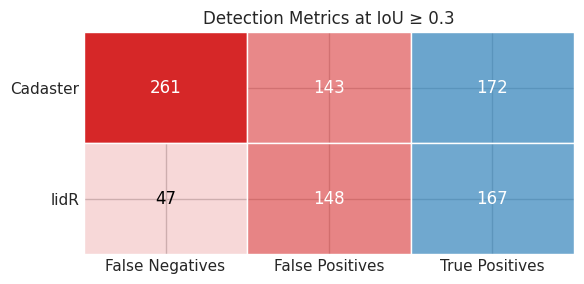

In [42]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

# Pivot into matrix form
conf_mat = metrics_data.pivot(index="Source", columns="Category", values="Count")

sources    = conf_mat.index.tolist()
categories = conf_mat.columns.tolist()
max_count  = conf_mat.values.max()

# Nicer “tab” colors from Matplotlib
base_colors = {
    "True Positives":   "tab:blue",  # clean blue
    "False Positives":  "tab:red",   # clean red
    "False Negatives":  "tab:red"
}

fig, ax = plt.subplots(figsize=(6, 3))

for i, src in enumerate(sources):
    for j, cat in enumerate(categories):
        cnt = conf_mat.loc[src, cat]
        rgba = mcolors.to_rgba(base_colors[cat], alpha=cnt / max_count)
        rect = plt.Rectangle((j, i), 1, 1, facecolor=rgba, edgecolor="white")
        ax.add_patch(rect)
        ax.text(j + 0.5, i + 0.5, f"{int(cnt)}",
                ha="center", va="center", color="white" if cnt/max_count>0.5 else "black", fontsize=12)

ax.set_xticks(np.arange(len(categories)) + 0.5)
ax.set_xticklabels(categories, rotation=0)
ax.set_yticks(np.arange(len(sources)) + 0.5)
ax.set_yticklabels(sources)
ax.set_xlim(0, len(categories))
ax.set_ylim(0, len(sources))
ax.invert_yaxis()
for spine in ax.spines.values():
    spine.set_visible(False)

# optionally remove the little tick‐marks if you find them distracting:
ax.tick_params(length=0)

plt.title(f"Detection Metrics at IoU ≥ {iou_thresh}")
plt.tight_layout()
plt.show()


# BAMFOREST

In [43]:
new_test_set_json_path = '/content/drive/MyDrive/masterthesis/data/instances_tree_TestSet12023.json'
new_raster_dir = "/content/drive/MyDrive/masterthesis/data/TestSet12023_imgs"

annotations_by_filename = {}
all_gts = []

In [44]:
print(f"Loading and processing {new_test_set_json_path}...")
try:
    with open(new_test_set_json_path, 'r') as f:
        coco_data = json.load(f)

    # Create a mapping from image ID to image filename
    images_map = {img['id']: img['file_name'] for img in coco_data['images']}

    # Group annotations by image ID
    for ann in coco_data['annotations']:
        image_id = ann['image_id']
        filename = images_map.get(image_id)
        if filename:
            if filename not in annotations_by_filename:
                annotations_by_filename[filename] = []
            annotations_by_filename[filename].append(ann['segmentation'])

    print(f"✅ Successfully processed annotations for {len(annotations_by_filename)} images.")

except FileNotFoundError:
    print(f"⚠️ ERROR: JSON file not found at '{new_test_set_json_path}'.")
    print("Please make sure you have uploaded the file and the path is correct.")
except Exception as e:
    print(f"An error occurred: {e}")

Loading and processing /content/drive/MyDrive/masterthesis/data/instances_tree_TestSet12023.json...
✅ Successfully processed annotations for 1665 images.


In [45]:
# Function to convert segmentation coordinates from the JSON file to a GeoDataFrame
def pixel_polygons_to_geodataframe(segmentations, transform, crs):
    """
    Converts a list of COCO-style segmentation coordinates (in pixels)
    to a GeoDataFrame with world coordinates.

    Args:
        segmentations (list): A list of segmentation coordinate lists.
                              e.g., [[[x1, y1, x2, y2, ...]], [[...]]]
        transform (affine.Affine): The affine transformation from the raster file.
        crs (rasterio.crs.CRS): The CRS from the raster file.

    Returns:
        geopandas.GeoDataFrame: A GeoDataFrame containing the polygons.
    """
    polygons = []
    for seg in segmentations:
        # Reshape the flat list of coordinates into pairs
        coords = np.array(seg[0]).reshape(-1, 2)
        # Use rasterio to transform pixel coordinates to world coordinates
        world_coords = [rasterio.transform.xy(transform, c[1], c[0]) for c in coords]
        if len(world_coords) >= 3: # A polygon needs at least 3 vertices
            polygons.append(Polygon(world_coords))

    gdf = gpd.GeoDataFrame(geometry=polygons, crs=crs)
    return gdf


def plot_prediction_world_coords(image_path, groundtruth_gdf=None, cadaster_gdf=None, pred_polygons=None):
    with rasterio.open(image_path) as src:
        image = src.read([1, 2, 3])
        image = np.moveaxis(image, 0, -1)
        crs = src.crs
        extent = [src.bounds.left, src.bounds.right, src.bounds.bottom, src.bounds.top]

    fig, ax = plt.subplots(figsize=(10, 10))
    ax.imshow(image, extent=extent)

    # Plot predicted polygons (in world coordinates)
    if pred_polygons is not None and not pred_polygons.empty:
        pred_polygons.boundary.plot(ax=ax, edgecolor="cyan", linewidth=2, linestyle="--", label="Predicted Crowns")

    # Ground truth crowns
    if groundtruth_gdf is not None and not groundtruth_gdf.empty:
        groundtruth_gdf.boundary.plot(ax=ax, edgecolor="orange", linewidth=2, label="lidR")

    # Cadaster buffer
    if cadaster_gdf is not None and not cadaster_gdf.empty:
        cadaster_gdf.boundary.plot(ax=ax, edgecolor="blue", linewidth=2, linestyle=":", label="Cadaster Buffer")

    ax.set_title(f"{model_label} - {os.path.basename(image_path)}")
    ax.set_xlabel("Easting (meters)")
    ax.set_ylabel("Northing (meters)")
    ax.legend()
    plt.tight_layout()
    plt.show()

def plot_prediction_img_coords(image_path, results, groundtruth_gdf=None, cadaster_gdf=None, pred_polygons=None):
    with rasterio.open(image_path) as src:
        image = src.read([1, 2, 3])
        image = np.moveaxis(image, 0, -1)
        height, width, _ = image.shape

        fig, ax = plt.subplots(figsize=(10, 10))
        ax.imshow(image)

        # Plot YOLO masks
        if results[0].masks is not None:
            for mask in results[0].masks.data:
                mask = mask.cpu().numpy()
                if mask.ndim == 3:
                    mask = mask[0]
                mask_resized = cv2.resize(mask, (width, height))
                ax.contour(mask_resized, levels=[0.5], colors='red', linewidths=1.5)

        # Plot YOLO boxes with confidence
        if results[0].boxes is not None:
            for box in results[0].boxes:
                x_min, y_min, x_max, y_max = box.xyxy[0].cpu().numpy()
                conf = float(box.conf.cpu().numpy())  # Extract confidence
                ax.add_patch(plt.Rectangle((x_min, y_min), x_max - x_min, y_max - y_min,
                                           edgecolor="lime", facecolor="none", linewidth=2))
                ax.text(x_min, y_min - 5, f'{conf:.2f}', color='yellow', fontsize=8, backgroundcolor='black')

        ax.set_title(f"{model_label} — {os.path.basename(image_path)}")
        ax.set_xlabel("Pixel X")
        ax.set_ylabel("Pixel Y")
        ax.legend(handles=[
            plt.Line2D([0], [0], color='red', lw=2, label='Mask Contour'),
            plt.Line2D([0], [0], color='lime', lw=2, label='Prediction Box')
        ])
        plt.tight_layout()
        plt.show()


In [46]:
# This cell sets up the environment and selects a random sample of 10 images to process.

# Check if the directory for the new test set exists
if not os.path.exists(new_raster_dir):
    print(f"⚠️ Directory not found: {new_raster_dir}")
    print("Please update the `new_raster_dir` variable and make sure the folder exists.")
else:
    # Get the list of all files available
    all_available_files = list(annotations_by_filename.keys())

    # Use random.sample(all_available_files, 10) for a random selection.
    files_to_process = all_available_files[:10]
    NUM_IMAGES_TO_PROCESS = len(files_to_process)

    print(f"Found {len(all_available_files)} total images. Selected {NUM_IMAGES_TO_PROCESS} for this run.")

    # Initialize lists to store metrics and predictions
    new_all_results = []
    all_preds_new = []
    all_gts_new = []

    # Initialize a list to store data for plotting
    visualization_data = []
    # Plot all the images we process in this sample run
    NUM_IMAGES_TO_PLOT = NUM_IMAGES_TO_PROCESS

    print("Setup complete. Ready to start processing the sample.")

Found 1665 total images. Selected 10 for this run.
Setup complete. Ready to start processing the sample.


In [47]:
# This cell groups the individual tile files into mosaics based on their names.

from collections import defaultdict
import math

# --- CONFIGURATION ---
# Assuming your 20m tiles form a 5x5 grid to create a 100m x 100m area.
MOSAIC_GRID_WIDTH = 5
MOSAIC_GRID_HEIGHT = 5
# --------------------

# Group files by their base name (e.g., 'Hain_117')
grouped_files = defaultdict(list)
for f in all_available_files:
    base_name = "_".join(f.split('_')[:-1]) # e.g., 'Hain_117'
    try:
        # Extract the numeric index
        index = int(f.split('_')[-1].split('.')[0])
        grouped_files[base_name].append({'file': f, 'index': index})
    except ValueError:
        continue # Skip files that don't end in a number

# Create mosaic groups of 25 (5x5) tiles
mosaic_groups = []
for base_name, files in grouped_files.items():
    # Sort files by index to ensure correct order
    files.sort(key=lambda x: x['index'])

    # Chunk the files into groups of 25
    chunk_size = MOSAIC_GRID_WIDTH * MOSAIC_GRID_HEIGHT
    for i in range(0, len(files), chunk_size):
        chunk = files[i:i+chunk_size]
        if len(chunk) == chunk_size: # Only process full mosaics
            mosaic_groups.append(chunk)

mosaic_groups = mosaic_groups[:10]
print(f"Successfully created {len(mosaic_groups)} mosaic groups to process.")
# Example of the first group:
# print(mosaic_groups[0])

Successfully created 10 mosaic groups to process.


In [53]:
def plot_prediction_on_downsampled_image(image_array, extent, groundtruth_gdf=None, pred_polygons=None, title=""):
    """
    Plots the downsampled image array with predictions.

    Args:
        image_array (np.ndarray): The downsampled (H, W, C) numpy array.
        extent (list): The georeferenced extent [left, right, bottom, top].
        groundtruth_gdf (gpd.GeoDataFrame): Ground truth polygons.
        pred_polygons (gpd.GeoDataFrame): Predicted polygons.
        title (str): The title for the plot.
    """
    fig, ax = plt.subplots(figsize=(10, 10))

    # Display the numpy array directly
    ax.imshow(image_array, extent=extent)

    # --- FIX APPLIED HERE ---
    # Plot predicted polygons (corrected syntax)
    if pred_polygons is not None and not pred_polygons.empty:
        pred_polygons.boundary.plot(ax=ax, edgecolor="cyan", linewidth=2, linestyle="--", label="Predicted Crowns")

    # --- FIX APPLIED HERE ---
    # Ground truth crowns (corrected syntax)
    if groundtruth_gdf is not None and not groundtruth_gdf.empty:
        groundtruth_gdf.boundary.plot(ax=ax, edgecolor="orange", linewidth=2, label="Ground Truth")

    ax.set_title(title)
    ax.set_xlabel("Easting (meters)")
    ax.set_ylabel("Northing (meters)")
    ax.legend()
    plt.tight_layout()
    plt.show()

In [50]:
# This new processing loop correctly assembles the ground truth annotations
# to match the merged image mosaic.

# --- Re-initialize lists ---
new_all_results = []
visualization_data = []
# --------------------------

for i, group in enumerate(mosaic_groups):
    mosaic_name = "_".join(group[0]['file'].split('_')[:-1]) + f"_mosaic_{i}"
    print(f"\n🔍 Processing {mosaic_name} ({len(group)} tiles)")

    # --- 1. Merge Images and Prepare for Annotations ---
    mosaic_array = None

    # --- MODIFICATION: We will collect pixel coordinates first ---
    all_mosaic_pixel_segmentations = []

    # Get metadata from the top-left tile, which defines the entire mosaic's origin
    first_tile_path = os.path.join(new_raster_dir, group[0]['file'])
    with rasterio.open(first_tile_path) as src:
        tile_height, tile_width = src.height, src.width
        mosaic_transform = src.transform # The transform for the whole mosaic
        crs = src.crs

    mosaic_shape = (3, tile_height * MOSAIC_GRID_HEIGHT, tile_width * MOSAIC_GRID_WIDTH)
    mosaic_array = np.zeros(mosaic_shape, dtype=np.uint8)

    for idx, tile_info in enumerate(group):
        row = idx // MOSAIC_GRID_WIDTH
        col = idx % MOSAIC_GRID_WIDTH

        tile_path = os.path.join(new_raster_dir, tile_info['file'])
        with rasterio.open(tile_path) as src:
            # Place the tile's pixels into the correct slot
            y_start, x_start = row * tile_height, col * tile_width
            mosaic_array[:, y_start:y_start+tile_height, x_start:x_start+tile_width] = src.read([1,2,3])

            # --- NEW ANNOTATION LOGIC ---
            # Get pixel annotations and add the correct row/col offset
            if tile_info['file'] in annotations_by_filename:
                for seg in annotations_by_filename[tile_info['file']]:
                    # Reshape [x1, y1, x2, y2...] into [[x1, y1], [x2, y2]...]
                    coords = np.array(seg[0]).reshape(-1, 2)
                    # Add the pixel offset based on the tile's position in the mosaic
                    coords[:, 0] += x_start # Add column offset to x-coordinates
                    coords[:, 1] += y_start # Add row offset to y-coordinates
                    # Flatten back and append to our list of mosaic-level segmentations
                    all_mosaic_pixel_segmentations.append([coords.flatten().tolist()])

    # --- 2. Convert All Offset Pixel Annotations to a Single GeoDataFrame ---
    # Now we convert all the corrected pixel coordinates to world coordinates
    # using the single, correct transform from the top-left tile.
    gdf_gt_mosaic = pixel_polygons_to_geodataframe(all_mosaic_pixel_segmentations, mosaic_transform, crs)
    print(f"  ✅ Correctly merged and aligned {len(gdf_gt_mosaic)} ground truth annotations.")

    # --- 3. Downsample and Predict (No Changes Here) ---
    DOWNSAMPLE_FACTOR = 5
    new_height = mosaic_shape[1] // DOWNSAMPLE_FACTOR
    new_width = mosaic_shape[2] // DOWNSAMPLE_FACTOR

    mosaic_to_resize = np.moveaxis(mosaic_array, 0, -1)
    img_to_predict = cv2.resize(mosaic_to_resize, (new_width, new_height), interpolation=cv2.INTER_AREA)
    output_shape_for_masks = (new_height, new_width)
    print(f"  Image merged and downsampled to {new_width}x{new_height}")

    results = model(img_to_predict, imgsz=640, conf=0.1, verbose=False)

    mosaic_bounds = rasterio.transform.array_bounds(mosaic_shape[1], mosaic_shape[2], mosaic_transform)

    if results[0].masks is None:
        gdf_pred = gpd.GeoDataFrame(geometry=[], crs=crs)
    else:
        masks = results[0].masks.data.cpu().numpy()
        scores = results[0].boxes.conf.cpu().numpy()
        gdf_pred = masks_to_polygons(masks, original_bounds=mosaic_bounds, out_shape=output_shape_for_masks, scores=scores)
        gdf_pred.set_crs(crs, inplace=True)

    # --- 4. Evaluate and Store (No Changes Here) ---
    scores_gt = evaluate_randcrowns(gdf_pred, gdf_gt_mosaic, iou_thresh=0.3)
    mean_gt = float(np.mean(scores_gt)) if scores_gt else 0.0

    new_all_results.append({
        "tile": mosaic_name,
        "mean_randcrowns_gt": mean_gt,
        "n_groundtruth": len(gdf_gt_mosaic),
        "n_predictions": len(gdf_pred)
    })
    print(f"  📊 Tile {mosaic_name}: Mean RandCrowns = {mean_gt:.3f}, N_GT = {len(gdf_gt_mosaic)}, N_Pred = {len(gdf_pred)}")

    visualization_data.append({
        'image_array': img_to_predict,
        'bounds': rasterio.coords.BoundingBox(*mosaic_bounds),
        'gdf_gt': gdf_gt_mosaic,
        'gdf_pred': gdf_pred,
        'tile_name': mosaic_name
    })

print(f"\n\n🎉 Processing complete for all {len(mosaic_groups)} mosaics.")


🔍 Processing Hain_117_mosaic_0 (25 tiles)
  ✅ Correctly merged and aligned 249 ground truth annotations.
  Image merged and downsampled to 1024x1024
  📊 Tile Hain_117_mosaic_0: Mean RandCrowns = 0.107, N_GT = 249, N_Pred = 125

🔍 Processing Hain_117_mosaic_1 (25 tiles)
  ✅ Correctly merged and aligned 147 ground truth annotations.
  Image merged and downsampled to 1024x1024
  📊 Tile Hain_117_mosaic_1: Mean RandCrowns = 0.259, N_GT = 147, N_Pred = 224

🔍 Processing Hain_117_mosaic_2 (25 tiles)
  ✅ Correctly merged and aligned 162 ground truth annotations.
  Image merged and downsampled to 1024x1024
  📊 Tile Hain_117_mosaic_2: Mean RandCrowns = 0.237, N_GT = 162, N_Pred = 119

🔍 Processing Hain_151_mosaic_3 (25 tiles)
  ✅ Correctly merged and aligned 188 ground truth annotations.
  Image merged and downsampled to 1024x1024
  📊 Tile Hain_151_mosaic_3: Mean RandCrowns = 0.238, N_GT = 188, N_Pred = 187

🔍 Processing Hain_151_mosaic_4 (25 tiles)
  ✅ Correctly merged and aligned 188 ground t

Displaying visual results for 10 merged mosaics...


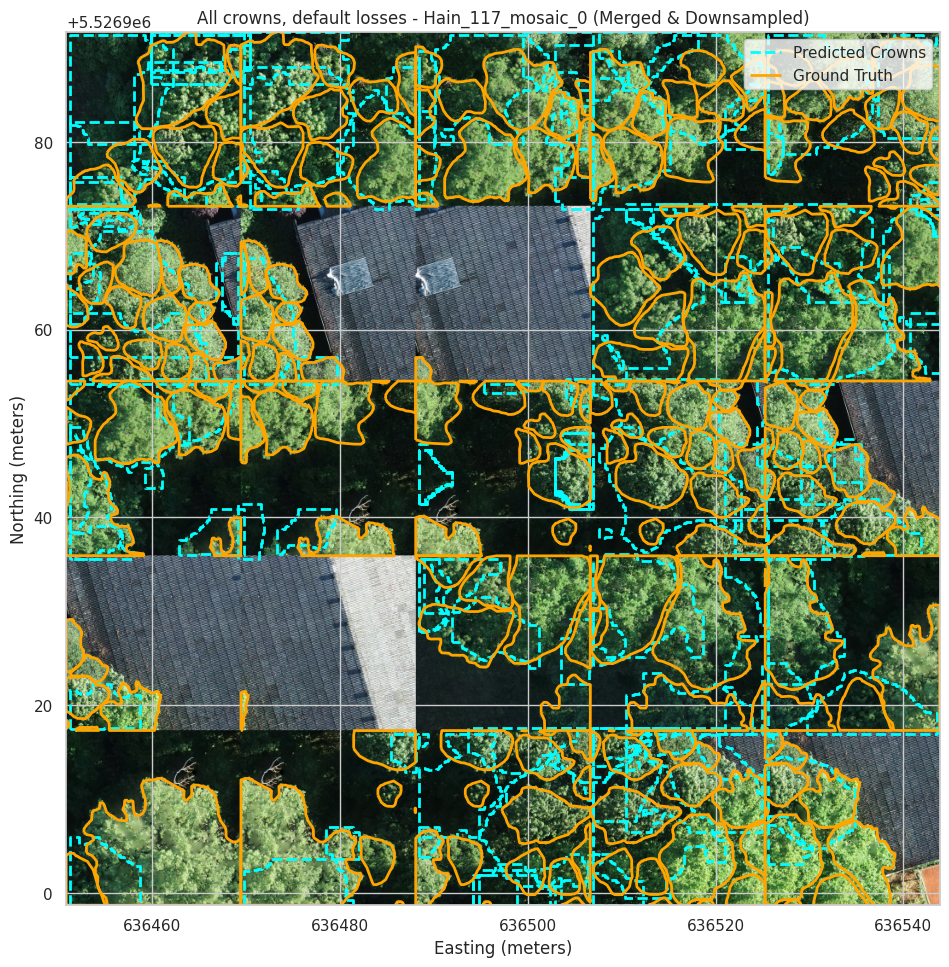

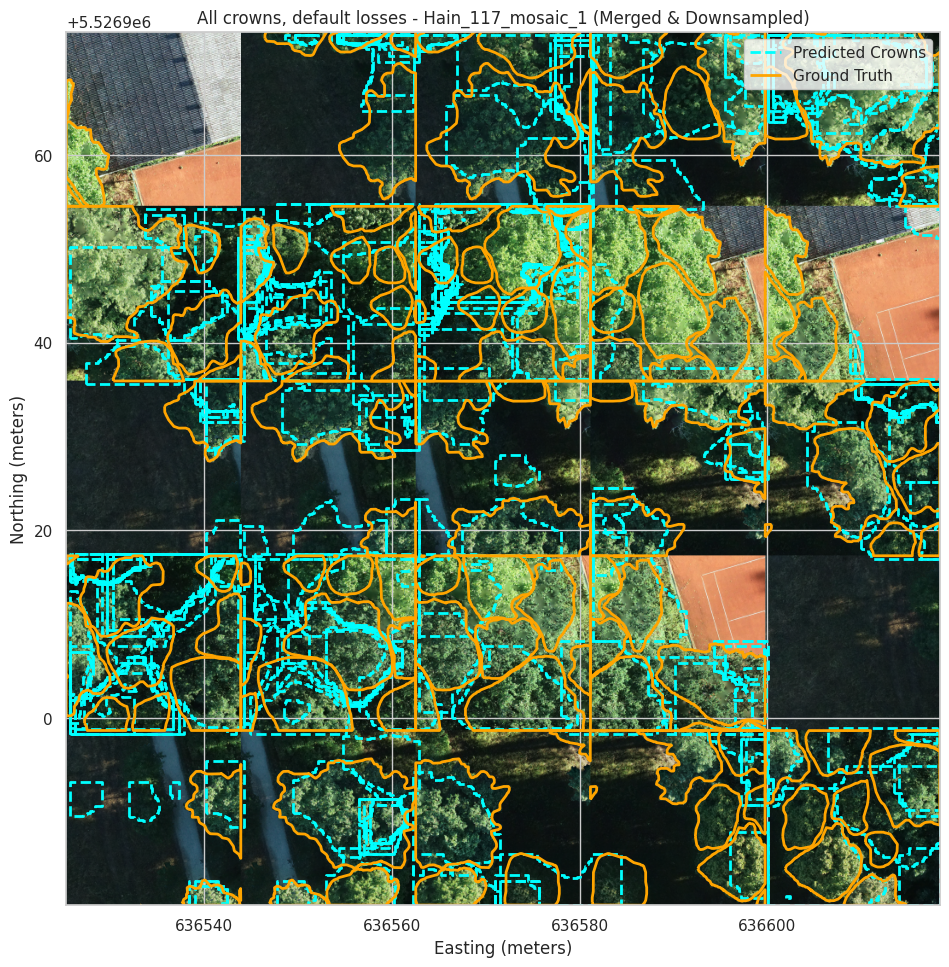

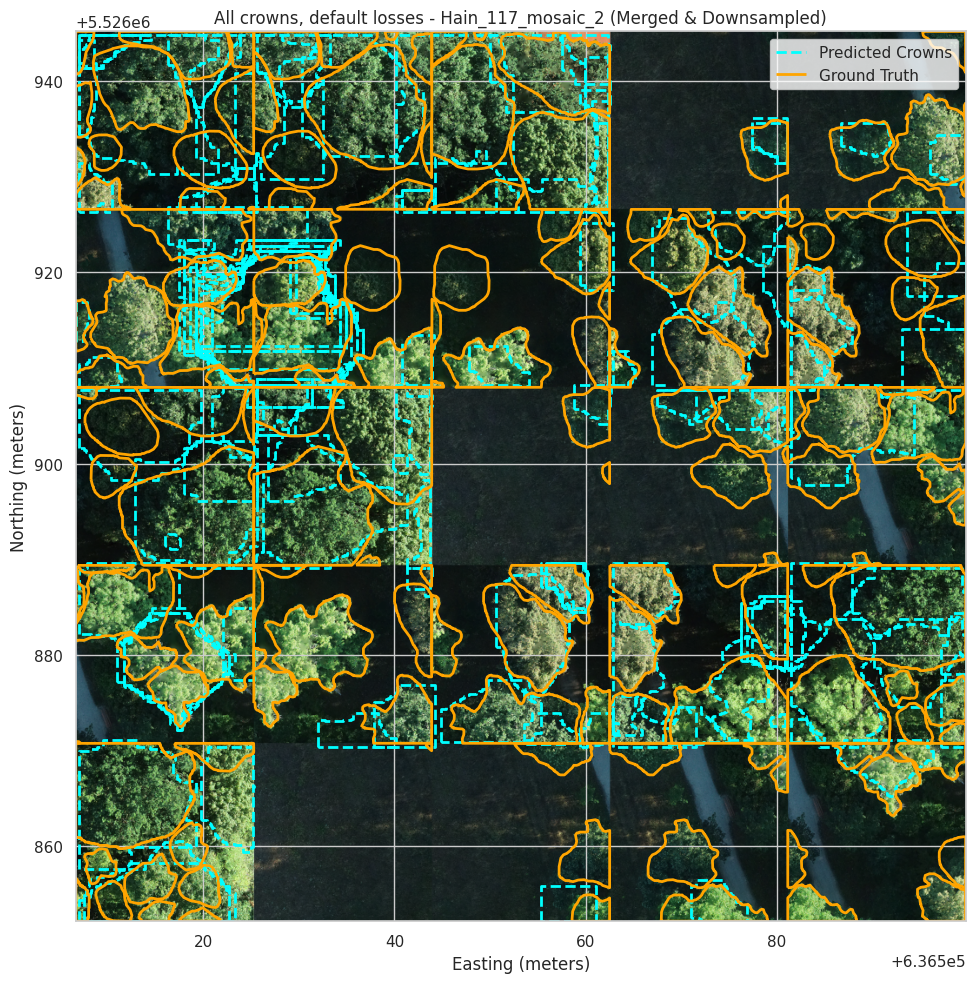

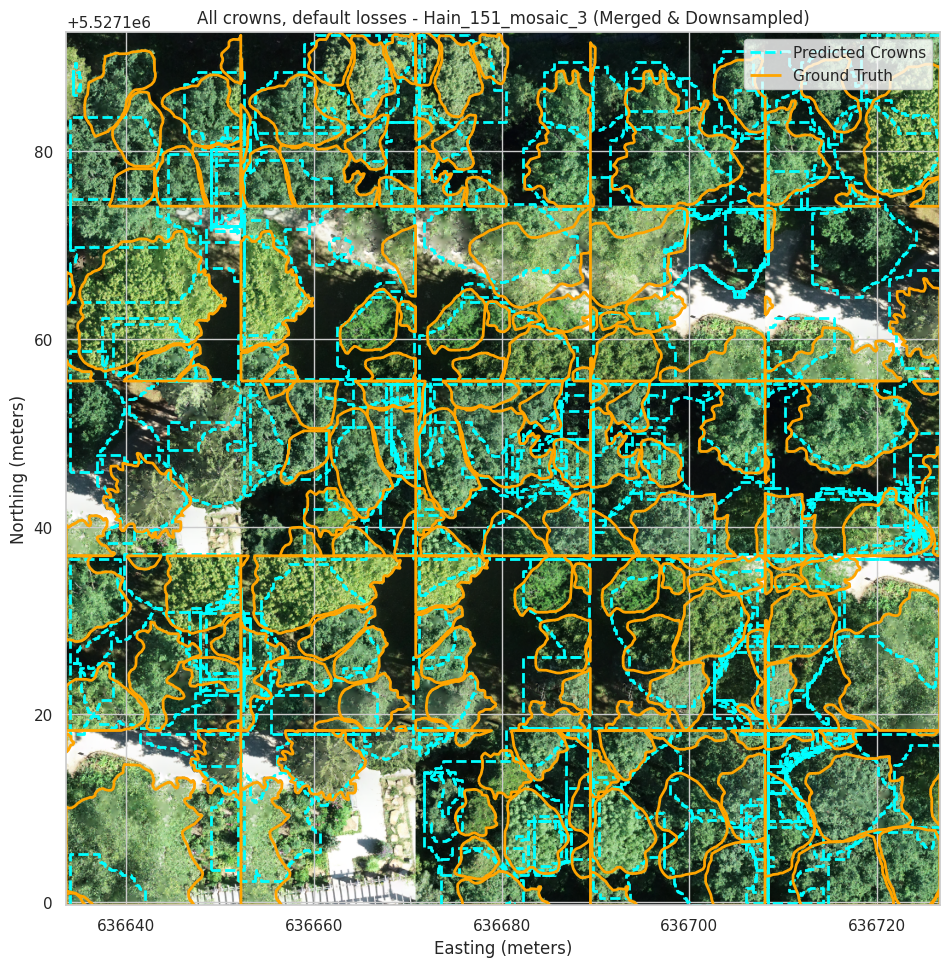

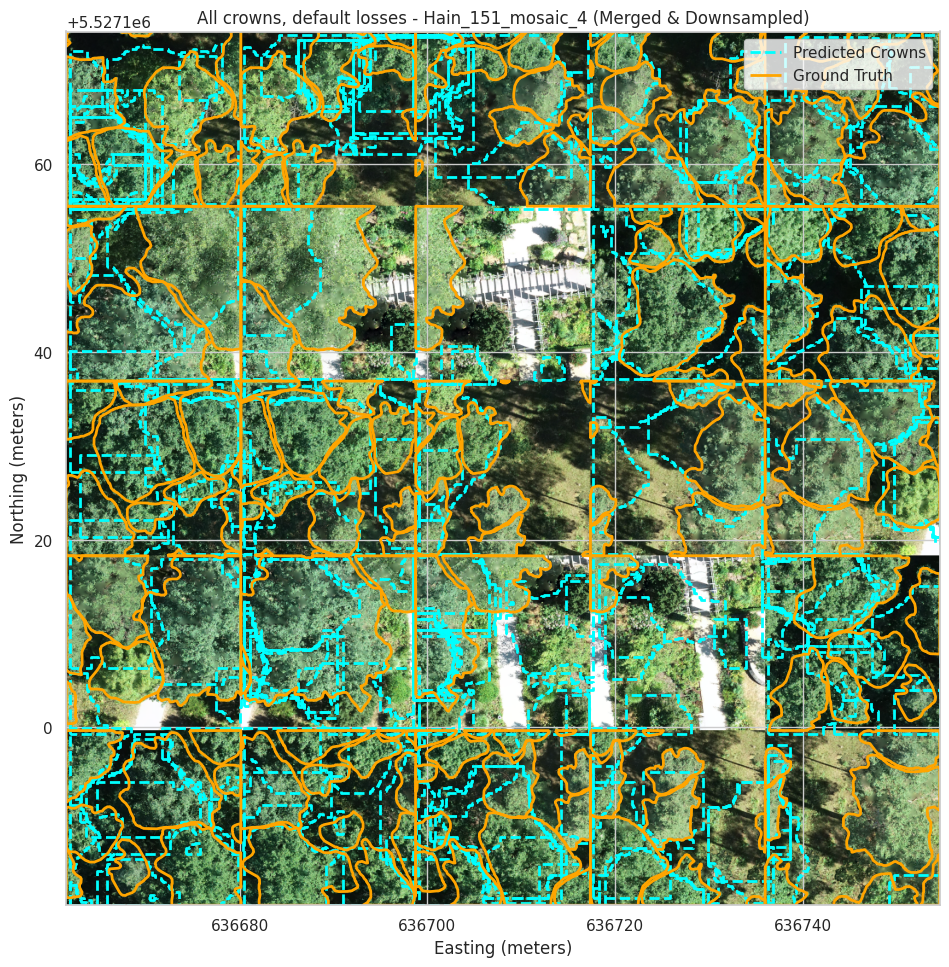

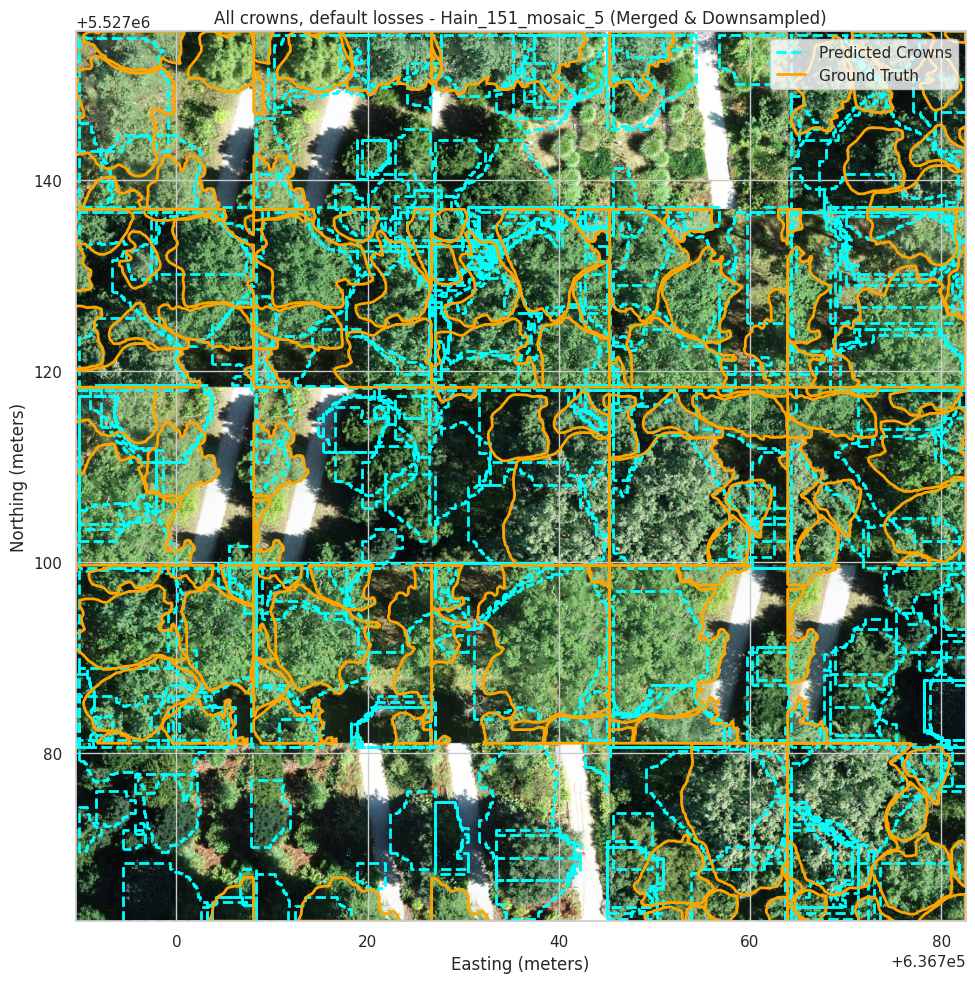

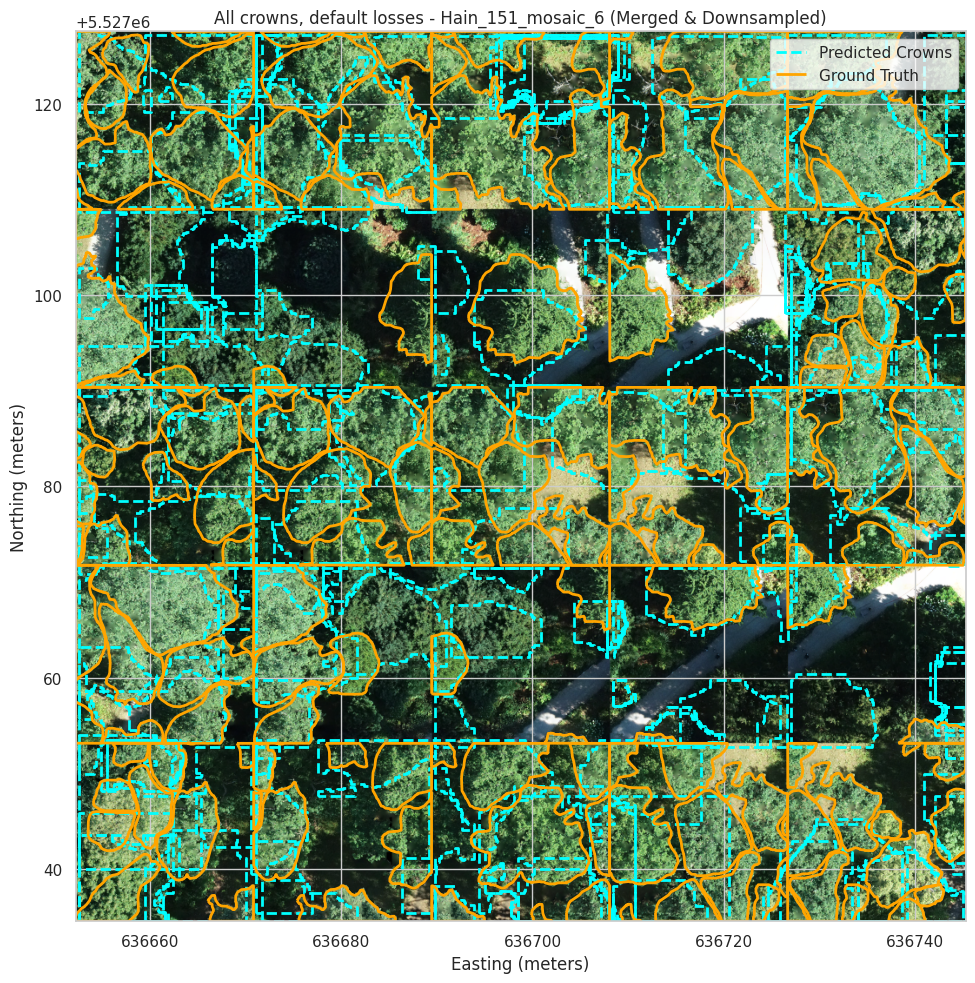

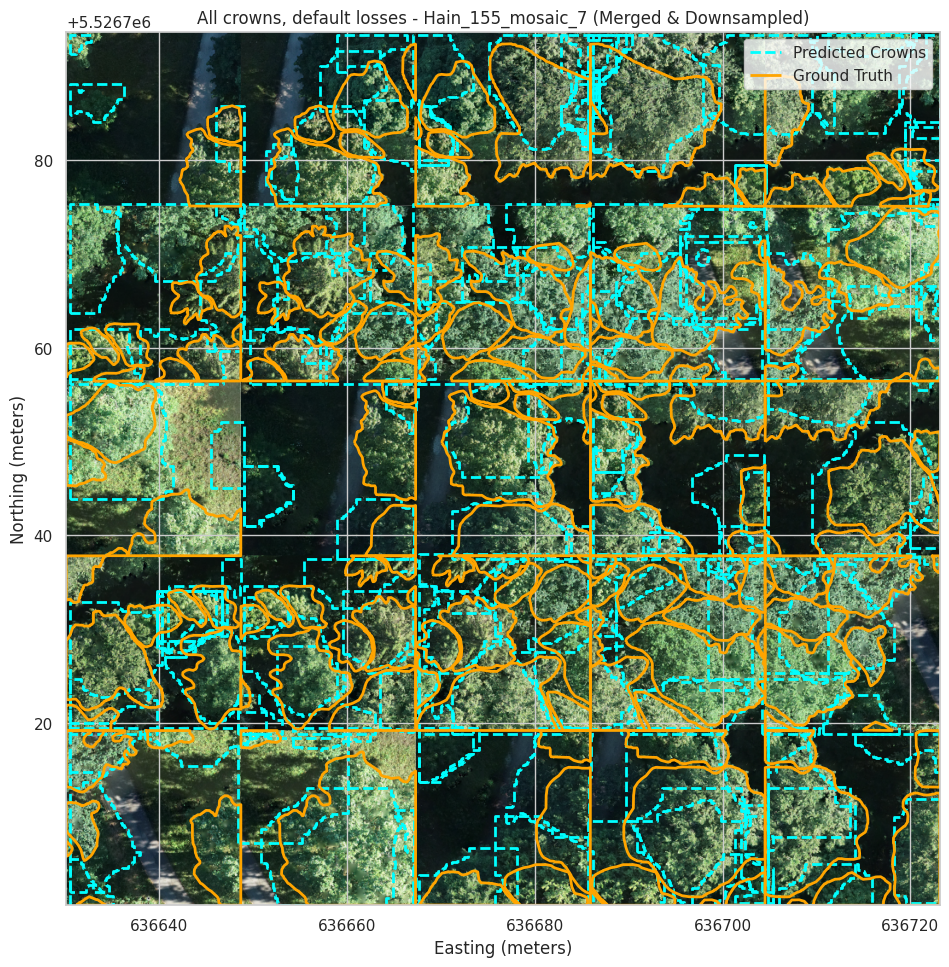

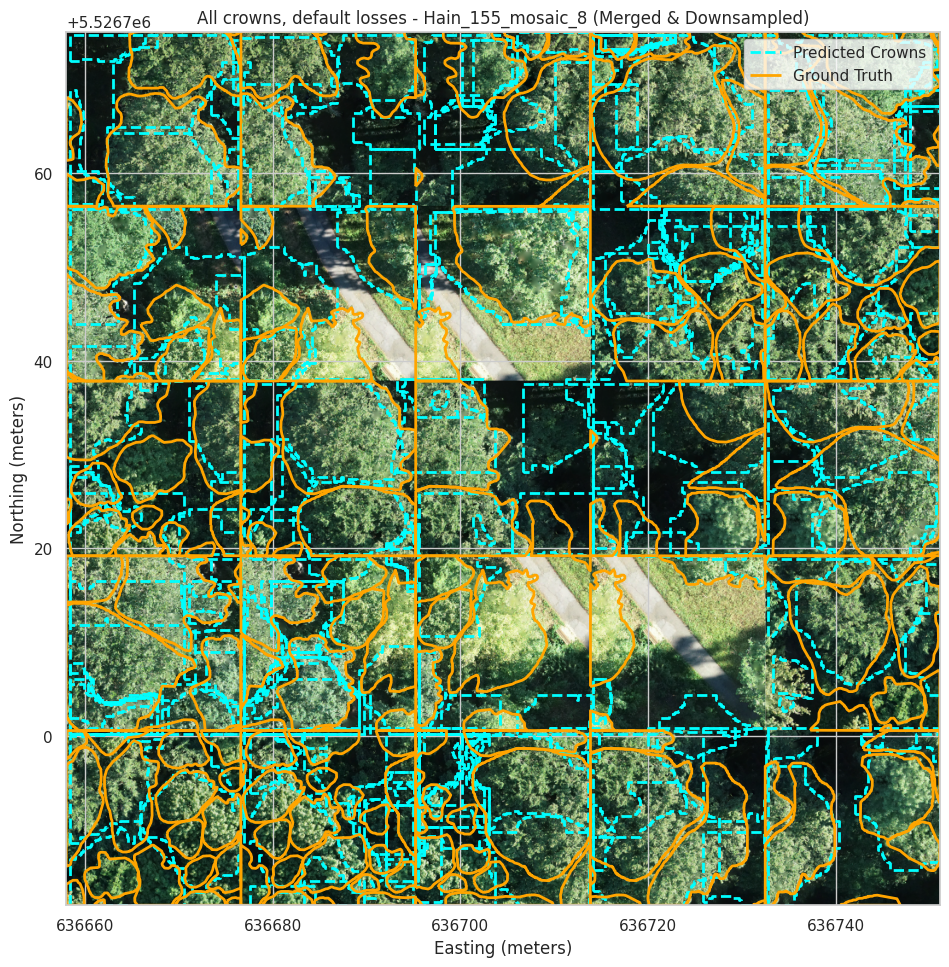

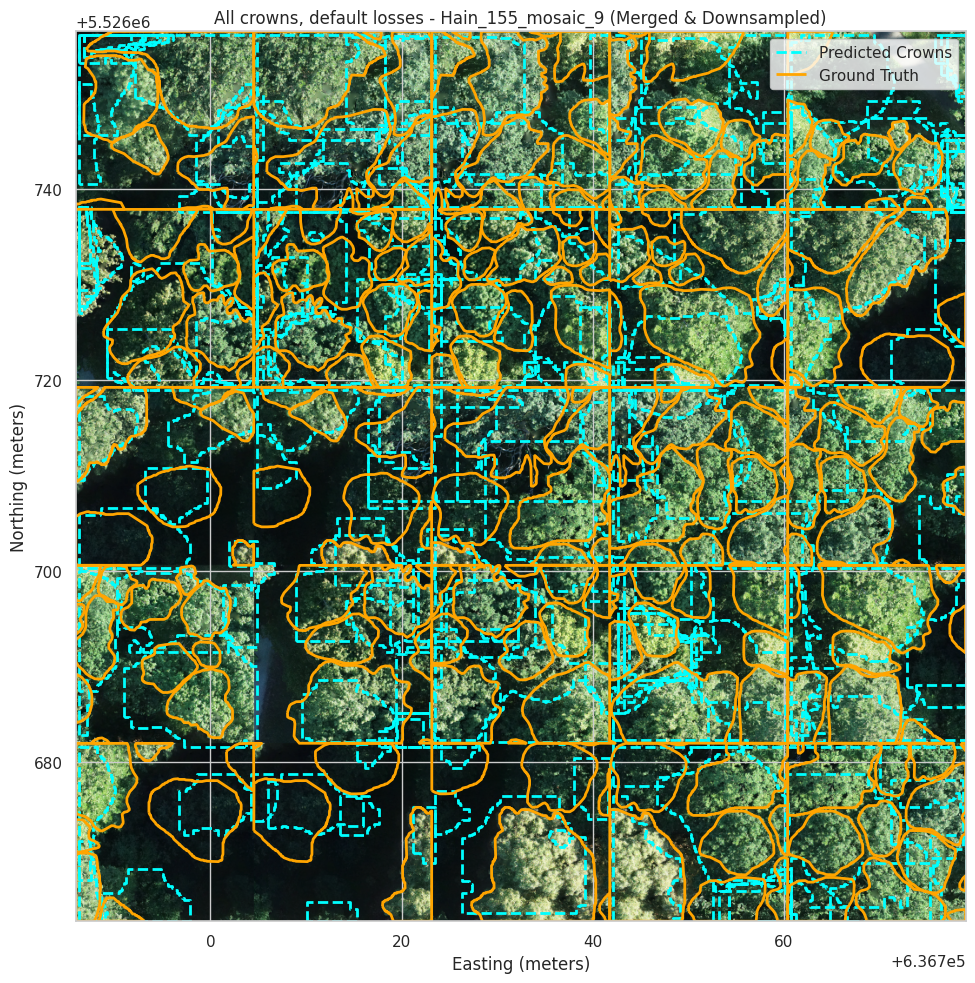

In [54]:
# This cell iterates through the visualization_data list and plots the
# results for each processed mosaic.

print(f"Displaying visual results for {len(visualization_data)} merged mosaics...")

if not visualization_data:
    print("\n⚠️ The visualization_data list is empty. Please ensure the previous processing cell ran correctly and generated results.")
else:
    for item in visualization_data:
        # Check that the dictionary has the required keys before trying to plot
        required_keys = ['image_array', 'bounds', 'gdf_gt', 'gdf_pred', 'tile_name']
        if not all(key in item for key in required_keys):
            print(f"--> Skipping an item in visualization_data because it's missing keys.")
            continue

        # Create the extent for plotting from the bounds object
        b = item['bounds']
        extent = [b.left, b.right, b.bottom, b.top]

        plot_title = f"{model_label} - {item['tile_name']} (Merged & Downsampled)"

        # Call the plotting function with the data from the dictionary
        plot_prediction_on_downsampled_image(
            image_array=item['image_array'],
            extent=extent,
            groundtruth_gdf=item['gdf_gt'],
            pred_polygons=item['gdf_pred'],
            title=plot_title
        )

In [ ]:
DOWNSAMPLE_FACTOR = 5
for tif_file in files_to_process:
    tile_name = tif_file.replace(".tif", "")
    raster_path = os.path.join(new_raster_dir, tif_file)
    print(f"\n🔍 Processing new tile: {tile_name}")

    if not os.path.exists(raster_path):
        print(f"  ⚠️ Raster file not found: {raster_path}. Skipping.")
        continue

    with rasterio.open(raster_path) as src:
        bounds = src.bounds
        crs = src.crs
        transform = src.transform
        tile_geom = box(*bounds)
        new_height = src.height // DOWNSAMPLE_FACTOR
        new_width = src.width // DOWNSAMPLE_FACTOR
        img_rgb = src.read(
            [1, 2, 3],
            out_shape=(3, new_height, new_width),
            resampling=rasterio.enums.Resampling.bilinear)
        output_shape_for_masks = (new_height, new_width)
        img_to_predict = np.moveaxis(img_rgb, 0, -1)
        print(f"  Image downsampled: original {src.width}x{src.height} -> new {new_width}x{new_height}")

    if tif_file in annotations_by_filename:
        segmentations = annotations_by_filename[tif_file]
        gdf_gt = pixel_polygons_to_geodataframe(segmentations, transform, crs)
        gdf_gt = gpd.clip(gdf_gt, tile_geom)
        all_gts_new.append(gdf_gt)
        print(f"  ✅ Generated ground truth for {tile_name} from JSON.")
    else:
        print(f"  ⚠️ No annotations found. Skipping.")
        continue

    results = model(img_to_predict, imgsz=640, conf=0.1, verbose=False)
    if results[0].masks is None:
        print("  No masks found in prediction.")
        gdf_pred = gpd.GeoDataFrame(geometry=[], crs=crs)
    else:
        masks = results[0].masks.data.cpu().numpy()
        scores = results[0].boxes.conf.cpu().numpy()
        gdf_pred = masks_to_polygons(masks, original_bounds=bounds, out_shape=output_shape_for_masks, scores=scores)
        gdf_pred.set_crs(crs, inplace=True)

    gdf_pred["tile"] = tile_name
    gdf_pred = gpd.clip(gdf_pred, tile_geom)
    all_preds_new.append(gdf_pred)

    scores_gt = evaluate_randcrowns(gdf_pred, gdf_gt, iou_thresh=0.3)
    mean_gt = float(np.mean(scores_gt)) if scores_gt else 0.0

    new_all_results.append({
        "tile": tile_name,
        "mean_randcrowns_gt": mean_gt,
        "n_groundtruth": len(gdf_gt),
        "n_predictions": len(gdf_pred)
    })
    print(f"  📊 Tile {tile_name}: Mean RandCrowns = {mean_gt:.3f}, N_GT = {len(gdf_gt)}, N_Pred = {len(gdf_pred)}")

    # We now correctly save the 'bounds' variable along with the other data.
    if len(visualization_data) < NUM_IMAGES_TO_PLOT:
        visualization_data.append({
            'image_array': img_to_predict,
            'bounds': bounds,
            'gdf_gt': gdf_gt,
            'gdf_pred': gdf_pred,
            'tile_name': tile_name
        })
        print(f"  ✅ Saved data for plotting (image {len(visualization_data)} of {NUM_IMAGES_TO_PLOT}).")

print(f"\n\n🎉 Processing complete for all {NUM_IMAGES_TO_PROCESS} images.")

In [ ]:
# This cell groups the individual tile files into mosaics based on their names.

from collections import defaultdict
import math

# --- CONFIGURATION ---
# Assuming your 20m tiles form a 5x5 grid to create a 100m x 100m area.
MOSAIC_GRID_WIDTH = 5
MOSAIC_GRID_HEIGHT = 5
# --------------------

# Group files by their base name (e.g., 'Hain_117')
grouped_files = defaultdict(list)
for f in all_available_files:
    base_name = "_".join(f.split('_')[:-1]) # e.g., 'Hain_117'
    try:
        # Extract the numeric index
        index = int(f.split('_')[-1].split('.')[0])
        grouped_files[base_name].append({'file': f, 'index': index})
    except ValueError:
        continue # Skip files that don't end in a number

# Create mosaic groups of 25 (5x5) tiles
mosaic_groups = []
for base_name, files in grouped_files.items():
    # Sort files by index to ensure correct order
    files.sort(key=lambda x: x['index'])

    # Chunk the files into groups of 25
    chunk_size = MOSAIC_GRID_WIDTH * MOSAIC_GRID_HEIGHT
    for i in range(0, len(files), chunk_size):
        chunk = files[i:i+chunk_size]
        if len(chunk) == chunk_size: # Only process full mosaics
            mosaic_groups.append(chunk)

print(f"Successfully created {len(mosaic_groups)} mosaic groups to process.")
# Example of the first group:
# print(mosaic_groups[0])

In [ ]:
len(visualization_data)

In [ ]:
# This cell now calls the new plotting function to show you exactly
# what the model saw during prediction.

print(f"Displaying visual results for {len(visualization_data)} images...")

for item in visualization_data:
    # Create the extent for plotting
    b = item['bounds']
    extent = [b.left, b.right, b.bottom, b.top]

    plot_title = f"{model_label} - {item['tile_name']} (Downsampled)"

    # Call the new function
    plot_prediction_on_downsampled_image(
        image_array=item['image_array'],
        extent=extent,
        groundtruth_gdf=item['gdf_gt'],
        pred_polygons=item['gdf_pred'],
        title=plot_title
    )

In [ ]:
print(f"Displaying visual results for {len(visualization_data)} images...")

for item in visualization_data:
    plot_prediction_world_coords(
        image_path=item['raster_path'],
        groundtruth_gdf=item['gdf_gt'],
        pred_polygons=item['gdf_pred']
    )

In [ ]:
# This cell calculates and displays the final summary statistics and plots
# based on the metrics gathered from ALL images.

if new_all_results:
    df_summary_new = pd.DataFrame(new_all_results)
    print("\n--- Summary DataFrame for New TestSet12023 ---")
    print(df_summary_new)

    # Save results to a CSV file
    output_csv_path = f"/content/drive/MyDrive/masterthesis/predictions/{model_name}_randcrowns_summary_TestSet12023.csv"
    df_summary_new.to_csv(output_csv_path, index=False)
    print(f"\n✅ Summary saved to {output_csv_path}")

    # --- Plotting the overall distribution ---
    plt.figure(figsize=(10, 6))
    sns.boxplot(data=df_summary_new, y="mean_randcrowns_gt", palette="Set2")
    sns.stripplot(data=df_summary_new, y="mean_randcrowns_gt", color="gray", alpha=0.6, jitter=True)
    plt.title(f"{model_label} - RandCrowns Score Distribution (TestSet12023)")
    plt.ylabel("Mean RandCrowns Score per Tile")
    plt.xlabel("Ground Truth vs. Prediction")
    plt.grid(True, axis='y')
    plt.tight_layout()
    plt.show()

    # --- Print Total Counts ---
    total_gt_new = df_summary_new["n_groundtruth"].sum()
    total_pred_new = df_summary_new["n_predictions"].sum()
    print("\n--- Total Counts for TestSet12023 ---")
    print(f"Total Ground Truth Trees: {total_gt_new}")
    print(f"Total Predicted Trees: {total_pred_new}")
    print(f"Deviation (Pred - GT): {total_pred_new - total_gt_new}")
else:
    print("\nNo results were generated to analyze.")